<a href="https://colab.research.google.com/github/srimayamohapatra/Crop-Production-in-India-/blob/main/Bi_Temporal_Crop_Health_Monitoring_Framework.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pip install rasterio numpy scikit-learn matplotlib

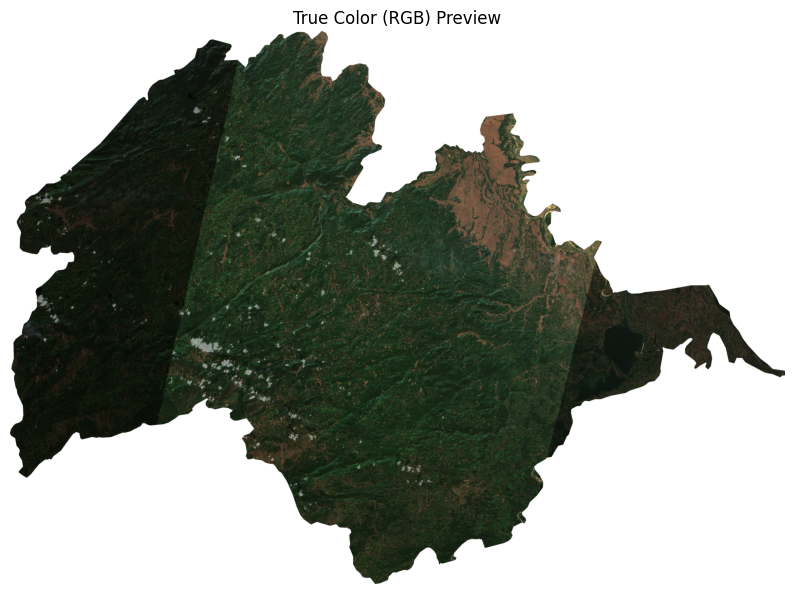

In [ ]:

import rasterio
import numpy as np
import matplotlib.pyplot as plt

file_path = "/content/KarbiAnglong2021.tif"

with rasterio.open(file_path) as src:
    # 1. Check if the file actually has 3 bands (Red, Green, Blue)
    if src.count < 3:
        print(f"⚠️ Warning: This file only has {src.count} band(s). It cannot be displayed as RGB.")
        # If it's 1 band, we just show it in gray
        data = src.read(1)
        plt.imshow(data, cmap='gray')
    else:
        # 2. Read all 3 bands (Assumes Band 1=Red, Band 2=Green, Band 3=Blue)
        # Note: Rasterio reads as (Bands, Height, Width) -> e.g. (3, 500, 500)
        r = src.read(1)
        g = src.read(2)
        b = src.read(3)

        # 3. Stack them into an image format Python likes: (Height, Width, 3)
        rgb_image = np.dstack((r, g, b))

        # 4. Normalize for Display (CRITICAL STEP)
        # Matplotlib expects values between 0.0 and 1.0 (Floats) or 0 and 255 (Integers).
        # Satellite data is often 0 to 10000 or 0 to 65535. We must scale it down.

        if rgb_image.max() > 255:
            # If values are huge (e.g. 3000), divide by a scaling factor to brighten it
            # Adjust '3000' if the image is too dark or too bright
            print(f"Scaling data... (Max value was {rgb_image.max()})")
            rgb_image = rgb_image.astype(float) / 3000.0
            rgb_image = np.clip(rgb_image, 0, 1) # Force values to stay between 0 and 1
        elif rgb_image.dtype != np.uint8:
            # If it's already small floats (0-1), just ensure it's clipped
            rgb_image = np.clip(rgb_image, 0, 1)

        # 5. Plot
        plt.figure(figsize=(10, 10))
        plt.title("True Color (RGB) Preview")
        plt.imshow(rgb_image)
        plt.axis('off')
        plt.show()

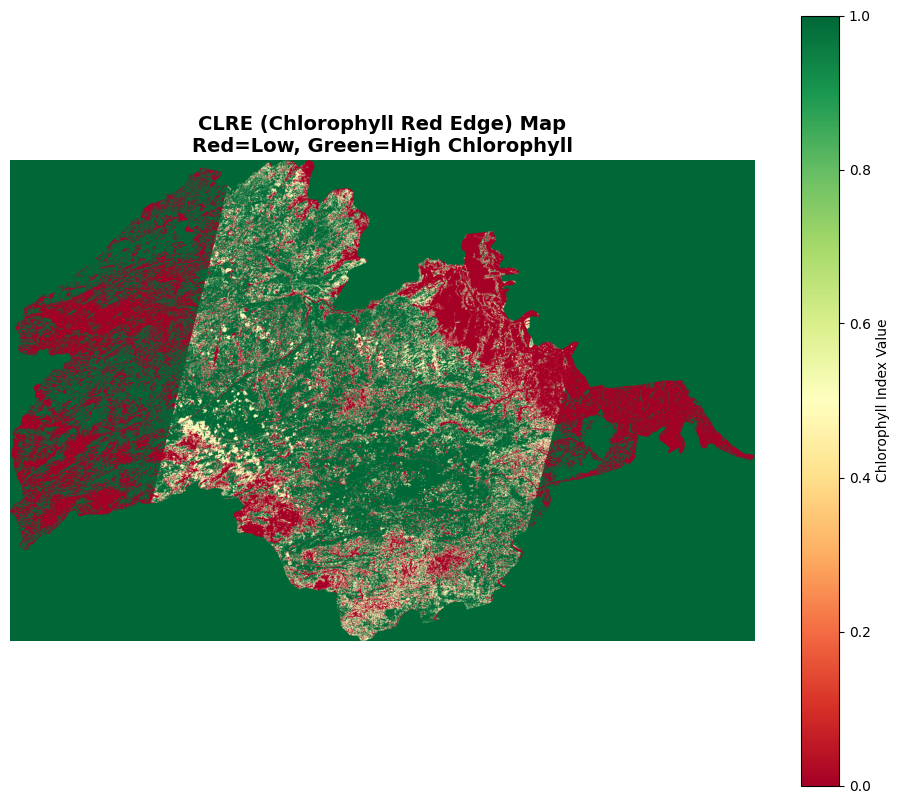

Stats: Min=-1.000, Max=2147483648.000, Mean=1067633600.000


In [ ]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import copy # Needed to modify the colormap safely

# ==========================================
# 1. SETUP PATH
# ==========================================
file_path = "/content/CLRE2021.tif"

# ==========================================
# 2. LOAD & VISUALIZE
# ==========================================
with rasterio.open(file_path) as src:
    data = src.read(1)

    # Clean data (Mask NoData and clip extreme outliers)
    data_masked = np.ma.masked_invalid(data)

    # CLRE typically ranges from 0 to 2.0.
    # We clip it to 0-1.5 to make the crop variation visible.
    data_masked = np.clip(data_masked, 0, 1.5)

    # ==========================================
    # 3. PLOT WITH WHITE BACKGROUND
    # ==========================================
    fig, ax = plt.subplots(figsize=(12, 10))

    # 1. FORCE THE FIGURE BACKGROUND TO BE WHITE
    fig.patch.set_facecolor('white')
    ax.set_facecolor('white')

    # 2. CUSTOMIZE COLORMAP FOR NODATA VALUES
    # We create a copy of the 'RdYlGn' map so we can change it
    my_cmap = copy.copy(plt.cm.RdYlGn)
    # Tell the map to paint any masked (NoData) pixels WHITE
    my_cmap.set_bad(color='white')

    # Use our custom colormap
    im = ax.imshow(data_masked, cmap=my_cmap, vmin=0, vmax=1.0)

    ax.set_title("CLRE (Chlorophyll Red Edge) Map\nRed=Low, Green=High Chlorophyll",
                 fontsize=14, fontweight='bold')

    plt.colorbar(im, ax=ax, label="Chlorophyll Index Value")
    ax.axis('off')

    plt.show()

    # Print stats to verify the range
    print(f"Stats: Min={np.nanmin(data):.3f}, Max={np.nanmax(data):.3f}, Mean={np.nanmean(data):.3f}")

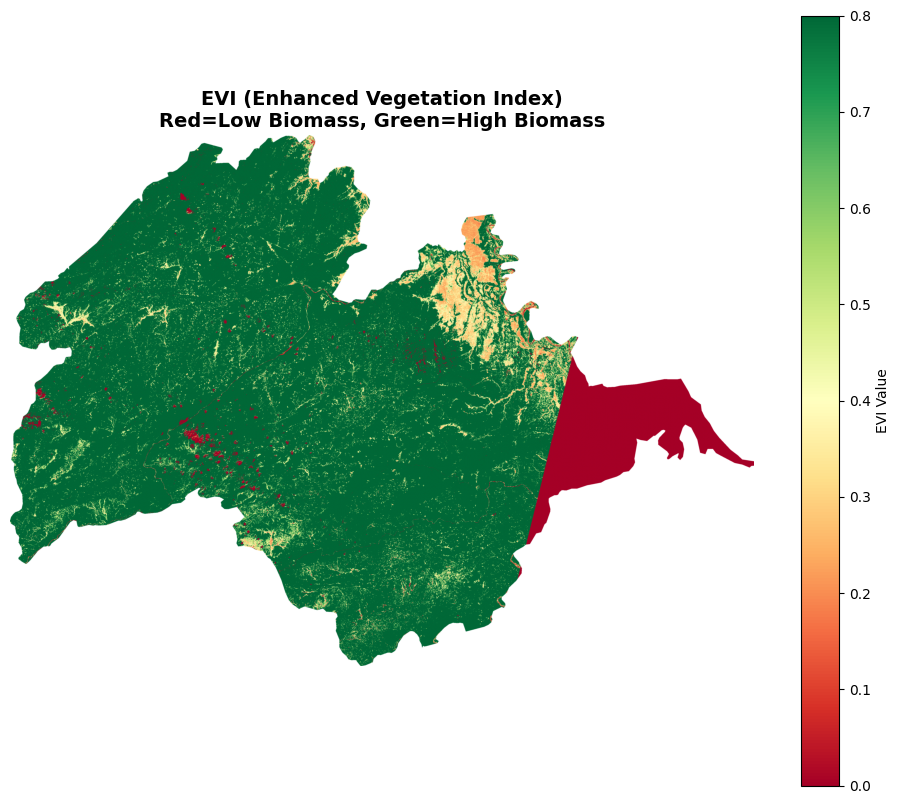

Stats: Min=-inf, Max=5490.000


In [ ]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import copy

# ==========================================
# 1. SETUP PATH
# ==========================================
# Note the comma in the filename based on your screenshot
file_path = "/content/EVI,2021.tif"

# ==========================================
# 2. LOAD & VISUALIZE
# ==========================================
if not os.path.exists(file_path):
    print(f"❌ Error: File not found at {file_path}")
else:
    with rasterio.open(file_path) as src:
        data = src.read(1)

        # Clean data (Mask NoData)
        data_masked = np.ma.masked_invalid(data)

        # EVI generally ranges from -1 to 1.
        # Vegetation is usually 0.2 to 0.8.
        # We set the display range from 0 to 0.8 for best contrast.
        data_masked = np.clip(data_masked, -0.2, 1.0)

        # ==========================================
        # 3. PLOT
        # ==========================================
        fig, ax = plt.subplots(figsize=(12, 10))

        # Force background to White
        fig.patch.set_facecolor('white')
        ax.set_facecolor('white')

        # Setup Colormap
        my_cmap = copy.copy(plt.cm.RdYlGn)
        my_cmap.set_bad(color='white') # Make empty pixels white

        # Plot
        im = ax.imshow(data_masked, cmap=my_cmap, vmin=0, vmax=0.8)

        ax.set_title("EVI (Enhanced Vegetation Index)\nRed=Low Biomass, Green=High Biomass",
                     fontsize=14, fontweight='bold')

        plt.colorbar(im, ax=ax, label="EVI Value")
        ax.axis('off')

        plt.show()

        # Print stats
        print(f"Stats: Min={np.nanmin(data):.3f}, Max={np.nanmax(data):.3f}")

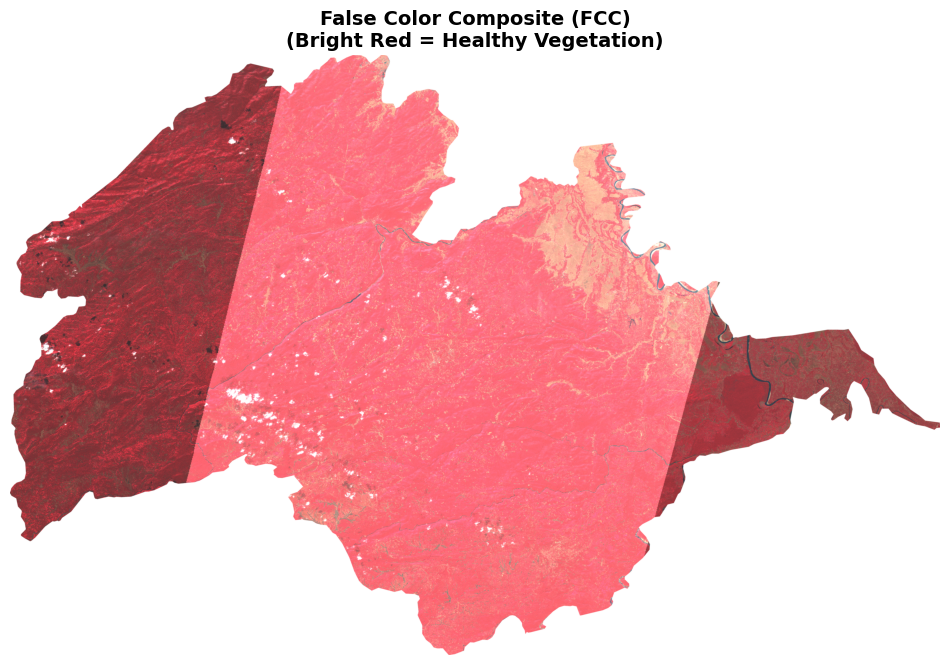

In [ ]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt

# ==========================================
# 1. SETUP PATH
# ==========================================
file_path = "/content/FCC,2021.tif"

# ==========================================
# 2. LOAD & PREPARE
# ==========================================
with rasterio.open(file_path) as src:
    # Read the 3 bands (Red, Green, Blue channels of the FCC)
    # Remember: In FCC, Red Channel = NIR (Vegetation)
    r = src.read(1)
    g = src.read(2)
    b = src.read(3)

    # Stack them into an RGB image
    fcc_image = np.dstack((r, g, b))

    # NORMALIZE (Scale to 0-1 for display)
    # Check if values are huge (e.g. 3000) or byte (0-255)
    if fcc_image.max() > 255:
        fcc_image = fcc_image.astype(float) / 3000.0
    elif fcc_image.max() > 1:
        fcc_image = fcc_image.astype(float) / 255.0

    # Clip to ensure no values exceed 1.0 (avoids whiteout)
    fcc_image = np.clip(fcc_image, 0, 1)

    # ==========================================
    # 3. PLOT
    # ==========================================
    fig, ax = plt.subplots(figsize=(12, 10))

    # Force pure white background
    fig.patch.set_facecolor('white')
    ax.set_facecolor('white')

    # Display the image
    ax.imshow(fcc_image)

    # Add Title
    ax.set_title("False Color Composite (FCC)\n(Bright Red = Healthy Vegetation)",
                 fontsize=14, fontweight='bold')

    # Hide Axis
    ax.axis('off')

    plt.show()

Raw Data Stats -> Min: 1955.00, Max: 2147483648.00
⚠ Detected raw integer data. Dividing by 10,000...


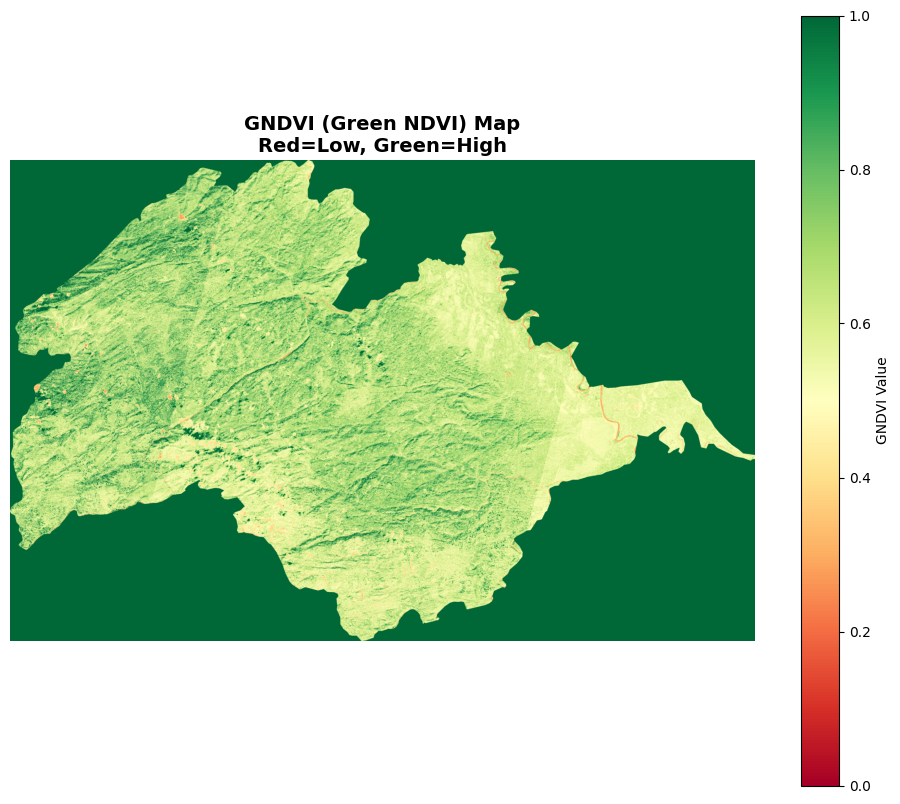

In [ ]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import copy

# ==========================================
# 1. SETUP PATH
# ==========================================
file_path = "/content/GNDVI2021.tif"

# ==========================================
# 2. LOAD & FIX DATA
# ==========================================
with rasterio.open(file_path) as src:
    data = src.read(1)

    # Check the raw stats BEFORE we do anything
    print(f"Raw Data Stats -> Min: {np.nanmin(data):.2f}, Max: {np.nanmax(data):.2f}")

    # FIX 1: HANDLE NODATA
    # Convert very large negative numbers (like -3.4e+38) to NaN
    data = np.where(data < -100, np.nan, data)

    # FIX 2: HANDLE SCALING
    # If the max value is huge (e.g. > 100), it's likely scaled by 10,000
    if np.nanmax(data) > 100:
        print("⚠ Detected raw integer data. Dividing by 10,000...")
        data = data / 10000.0

    # Mask NaNs so they don't mess up the plot
    data_masked = np.ma.masked_invalid(data)

    # Clip to standard GNDVI range (0 to 1) to remove sparkles/noise
    data_masked = np.clip(data_masked, 0, 1.0)

    # ==========================================
    # 3. PLOT
    # ==========================================
    fig, ax = plt.subplots(figsize=(12, 10))

    # Force White Background
    fig.patch.set_facecolor('white')
    ax.set_facecolor('white')

    # Setup Colormap
    my_cmap = copy.copy(plt.cm.RdYlGn)
    my_cmap.set_bad(color='white')

    # Plot
    im = ax.imshow(data_masked, cmap=my_cmap, vmin=0, vmax=1.0)

    ax.set_title("GNDVI (Green NDVI) Map\nRed=Low, Green=High",
                 fontsize=14, fontweight='bold')

    plt.colorbar(im, ax=ax, label="GNDVI Value")
    ax.axis('off')

    plt.show()

Raw Data Stats -> Min: 2230.00, Max: 2147483648.00
⚠ Detected raw integers (e.g. 5000). Scaling down by 10,000...


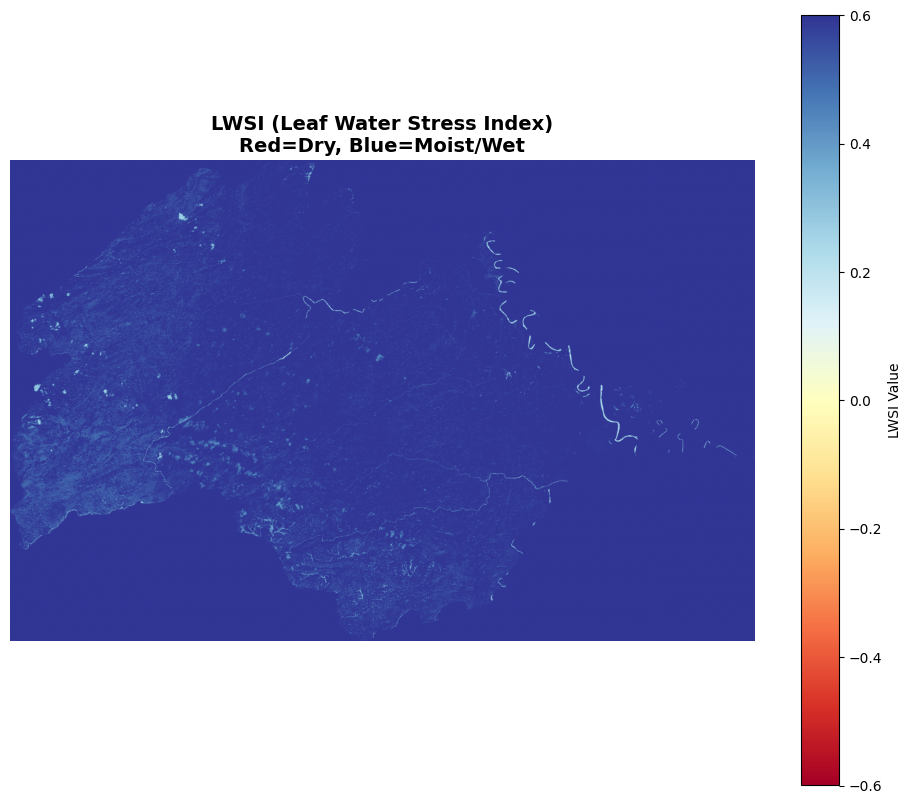

Final Display Stats -> Min: 0.223, Max: 0.600


In [ ]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import copy

# ==========================================
# 1. SETUP PATH
# ==========================================
file_path = "/content/LWSI,2021.tif"

# ==========================================
# 2. LOAD & AUTO-REPAIR DATA
# ==========================================
with rasterio.open(file_path) as src:
    data = src.read(1)

    # DEBUG: Print raw stats to see what's wrong
    print(f"Raw Data Stats -> Min: {np.nanmin(data):.2f}, Max: {np.nanmax(data):.2f}")

    # FIX A: Handle huge NoData values (negative infinity)
    # Convert anything smaller than -100 to NaN
    data = np.where(data < -100, np.nan, data)

    # FIX B: Handle Integer Scaling (e.g. 5000 instead of 0.5)
    # If the max value is > 10, we assume it needs to be divided by 10,000
    if np.nanmax(data) > 10:
        print("⚠ Detected raw integers (e.g. 5000). Scaling down by 10,000...")
        data = data / 10000.0

    # FIX C: Clip outliers to ensure good contrast
    # LWSI usually stays between -0.8 and 0.8.
    # We clip it so one bright pixel doesn't ruin the whole map.
    data_masked = np.ma.masked_invalid(data)
    data_masked = np.clip(data_masked, -0.6, 0.6)

    # ==========================================
    # 3. PLOT WITH WHITE BACKGROUND
    # ==========================================
    fig, ax = plt.subplots(figsize=(12, 10))

    # Force pure white background
    fig.patch.set_facecolor('white')
    ax.set_facecolor('white')

    # Setup Color Map: Red=Dry, Blue=Wet
    my_cmap = copy.copy(plt.cm.RdYlBu)
    my_cmap.set_bad(color='white') # NoData becomes White

    # Plot with fixed range (-0.6 to 0.6 gives best contrast for LWSI)
    im = ax.imshow(data_masked, cmap=my_cmap, vmin=-0.6, vmax=0.6)

    ax.set_title("LWSI (Leaf Water Stress Index)\nRed=Dry, Blue=Moist/Wet",
                 fontsize=14, fontweight='bold')

    plt.colorbar(im, ax=ax, label="LWSI Value")
    ax.axis('off')

    plt.show()

    # Print final stats
    print(f"Final Display Stats -> Min: {np.nanmin(data_masked):.3f}, Max: {np.nanmax(data_masked):.3f}")

📊 RAW STATS -> Min: -433.8000, Max: 3718.8000, Mean: 491.0449
⚠ Data values are huge (>10). Dividing by 10,000 to normalize...
✂ Clipping display range to: 0.0186 - 0.0912


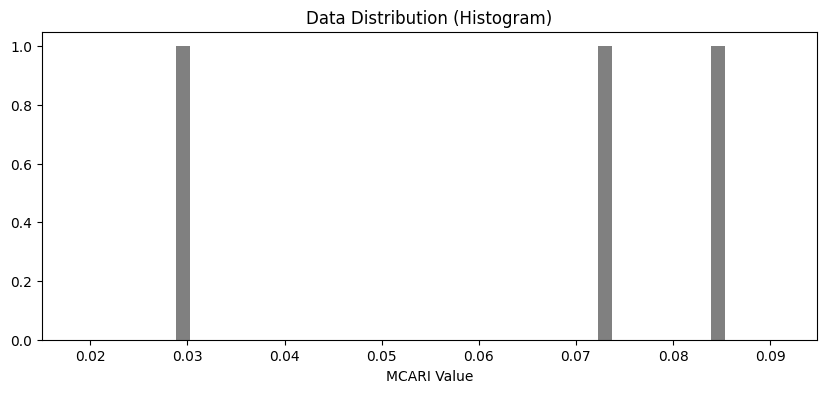

⚖ Using Auto-Threshold: 0.0491


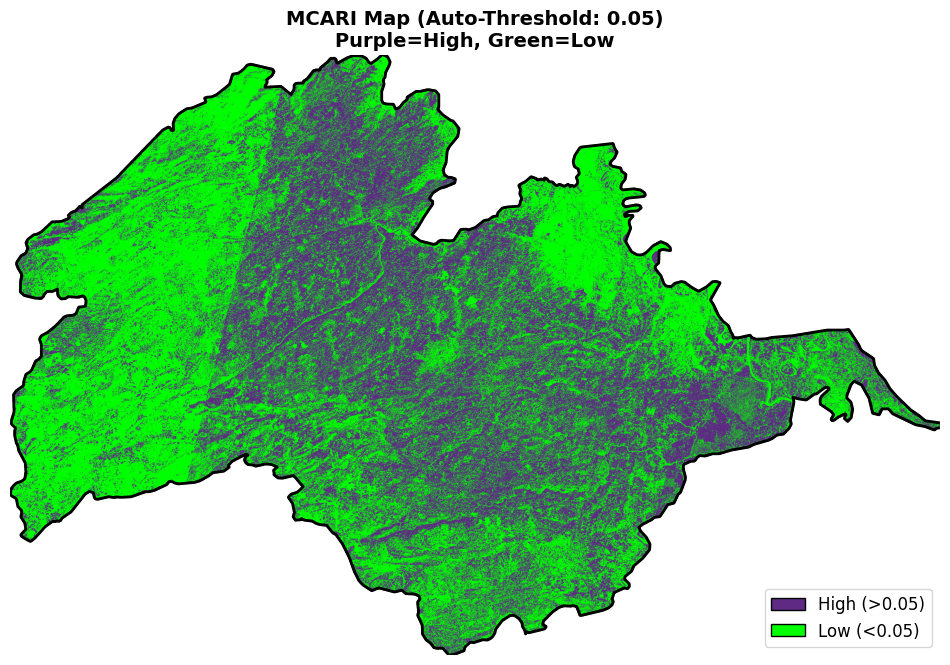

In [ ]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# ==========================================
# 1. SETUP PATH
# ==========================================
file_path = "/content/MCARI2021.tif"

# ==========================================
# 2. LOAD DATA
# ==========================================
with rasterio.open(file_path) as src:
    data = src.read(1)

    # Replace "NoData" values (usually huge negatives) with NaN
    data = np.where(data < -1000, np.nan, data)

    # --------------------------------------
    # DIAGNOSTIC STEP: PRINT RAW STATS
    # --------------------------------------
    valid_data = data[~np.isnan(data)]
    if len(valid_data) == 0:
        print("❌ ERROR: The file seems to be empty or all NoData.")
    else:
        print(f"📊 RAW STATS -> Min: {np.nanmin(data):.4f}, Max: {np.nanmax(data):.4f}, Mean: {np.nanmean(data):.4f}")

        # Check for integer scaling (e.g., 0-10000 range)
        if np.nanmax(data) > 10:
            print("⚠ Data values are huge (>10). Dividing by 10,000 to normalize...")
            data = data / 10000.0

    # --------------------------------------
    # FIX STEP: ROBUST CLIPPING
    # --------------------------------------
    # We clip the data to the 2nd and 98th percentile.
    # This removes random bright pixels that ruin the map.
    vmin, vmax = np.nanpercentile(data, [2, 98])
    print(f"✂ Clipping display range to: {vmin:.4f} - {vmax:.4f}")

    data_clipped = np.clip(data, vmin, vmax)
    data_masked = np.ma.masked_invalid(data_clipped)

    # ==========================================
    # 3. PLOT HISTOGRAM (To understand the data)
    # ==========================================
    fig_hist, ax_hist = plt.subplots(figsize=(10, 4))
    ax_hist.hist(valid_data.flatten(), bins=50, color='gray', range=(vmin, vmax))
    ax_hist.set_title("Data Distribution (Histogram)")
    ax_hist.set_xlabel("MCARI Value")
    plt.show()

    # ==========================================
    # 4. PLOT THE MAP (Purple/Green)
    # ==========================================
    fig, ax = plt.subplots(figsize=(12, 10))
    fig.patch.set_facecolor('white')
    ax.set_facecolor('white')

    # Define Colors: Green (Low) -> Purple (High)
    colors = ['#00ff00', '#5e2a84']
    cmap_custom = mcolors.ListedColormap(colors)
    cmap_custom.set_bad(color='white')

    # Define Threshold
    # We set the threshold to the MEAN value automatically.
    # This ensures roughly half the map is Green and half is Purple.
    auto_threshold = np.nanmean(data)
    print(f"⚖ Using Auto-Threshold: {auto_threshold:.4f}")

    bounds = [vmin, auto_threshold, vmax]
    norm = mcolors.BoundaryNorm(bounds, cmap_custom.N)

    # Plot
    im = ax.imshow(data_masked, cmap=cmap_custom, norm=norm)

    # Border
    mask_valid = (~np.ma.getmask(data_masked)).astype(int)
    if np.any(mask_valid):
        ax.contour(mask_valid, levels=[0.5], colors='black', linewidths=2)

    ax.set_title(f"MCARI Map (Auto-Threshold: {auto_threshold:.2f})\nPurple=High, Green=Low",
                 fontsize=14, fontweight='bold')
    ax.axis('off')

    # Legend
    from matplotlib.patches import Patch
    legend_elements = [
        Patch(facecolor=colors[1], edgecolor='black', label=f'High (>{auto_threshold:.2f})'),
        Patch(facecolor=colors[0], edgecolor='black', label=f'Low (<{auto_threshold:.2f})')
    ]
    ax.legend(handles=legend_elements, loc='lower right', fontsize=12)

    plt.show()

📊 RAW STATS -> Min: 0.00, Max: 65536.00
⚠ Detected large integers. Dividing by 10,000...
⚖ Calculated Auto-Threshold: 0.000


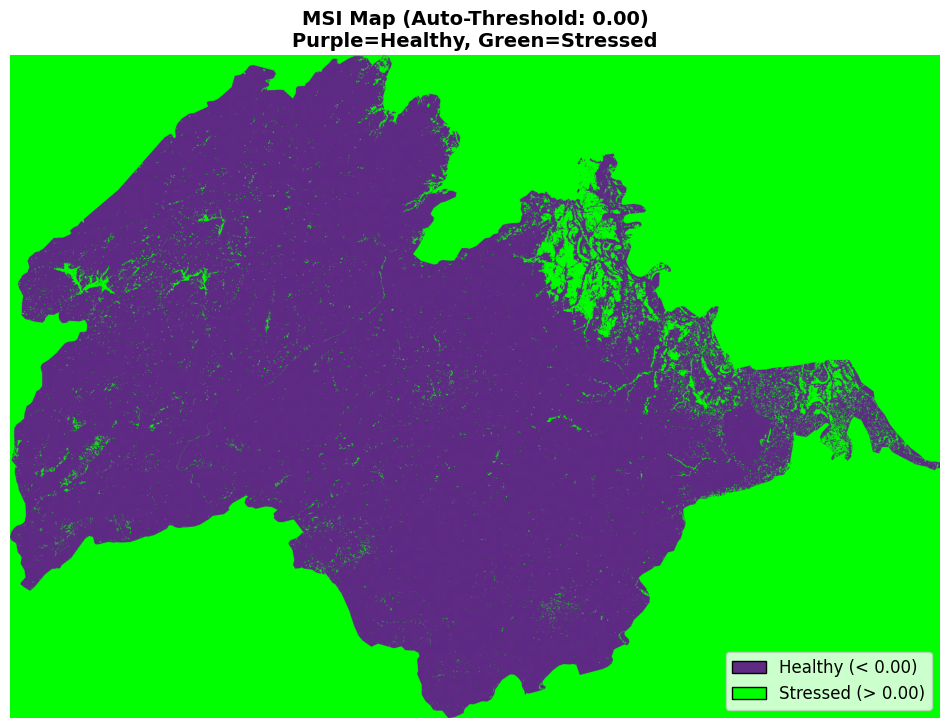

In [ ]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# ==========================================
# 1. SETUP PATH
# ==========================================
file_path = "/content/MSI,2021.tif"

# ==========================================
# 2. LOAD & DIAGNOSE DATA
# ==========================================
with rasterio.open(file_path) as src:
    data = src.read(1)

    # Replace NoData (huge negatives) with NaN
    data = np.where(data < -100, np.nan, data)

    # --------------------------------------
    # STEP A: CHECK RAW STATS
    # --------------------------------------
    valid_pixels = data[~np.isnan(data)]
    if len(valid_pixels) == 0:
        print("❌ ERROR: File is empty or all NoData.")
    else:
        raw_max = np.nanmax(data)
        print(f"📊 RAW STATS -> Min: {np.nanmin(data):.2f}, Max: {raw_max:.2f}")

        # --------------------------------------
        # STEP B: AUTO-FIX SCALING
        # --------------------------------------
        # If max value is > 10, it's likely 0-10000 scale. We fix it.
        if raw_max > 10:
            print("⚠ Detected large integers. Dividing by 10,000...")
            data = data / 10000.0

        # Clip strictly to 0-4 range (MSI rarely goes higher) to remove glitches
        data = np.clip(data, 0, 4.0)
        data_masked = np.ma.masked_invalid(data)

        # --------------------------------------
        # STEP C: AUTO-CALCULATE THRESHOLD
        # --------------------------------------
        # We set the split point at the MEDIAN value.
        # This guarantees roughly 50% Purple and 50% Green.
        auto_threshold = np.nanmedian(data)
        print(f"⚖ Calculated Auto-Threshold: {auto_threshold:.3f}")

        # ==========================================
        # 3. PLOT MAP
        # ==========================================
        fig, ax = plt.subplots(figsize=(12, 10))

        # Force White Background
        fig.patch.set_facecolor('white')
        ax.set_facecolor('white')

        # Define Colors: Purple (Healthy/Low) -> Green (Stressed/High)
        colors = ['#5e2a84', '#00ff00']
        cmap_custom = mcolors.ListedColormap(colors)
        cmap_custom.set_bad(color='white')

        # Create Norm based on Auto-Threshold
        # 0 to Threshold -> Purple
        # Threshold to 4.0 -> Green
        bounds = [0, auto_threshold, 4.0]
        norm = mcolors.BoundaryNorm(bounds, cmap_custom.N)

        # Plot
        im = ax.imshow(data_masked, cmap=cmap_custom, norm=norm)

        # Add Border
        mask_valid = (~np.ma.getmask(data_masked)).astype(int)
        if np.any(mask_valid):
            ax.contour(mask_valid, levels=[0.5], colors='black', linewidths=2)

        # Title & Legend
        ax.set_title(f"MSI Map (Auto-Threshold: {auto_threshold:.2f})\nPurple=Healthy, Green=Stressed",
                     fontsize=14, fontweight='bold')

        from matplotlib.patches import Patch
        legend_elements = [
            Patch(facecolor=colors[0], edgecolor='black', label=f'Healthy (< {auto_threshold:.2f})'),
            Patch(facecolor=colors[1], edgecolor='black', label=f'Stressed (> {auto_threshold:.2f})')
        ]
        ax.legend(handles=legend_elements, loc='lower right', fontsize=12)

        ax.axis('off')
        plt.show()

Raw Data Stats -> Min: 1267.50, Max: 2147483648.00
⚠ Detected integer scaling. Dividing by 10,000...


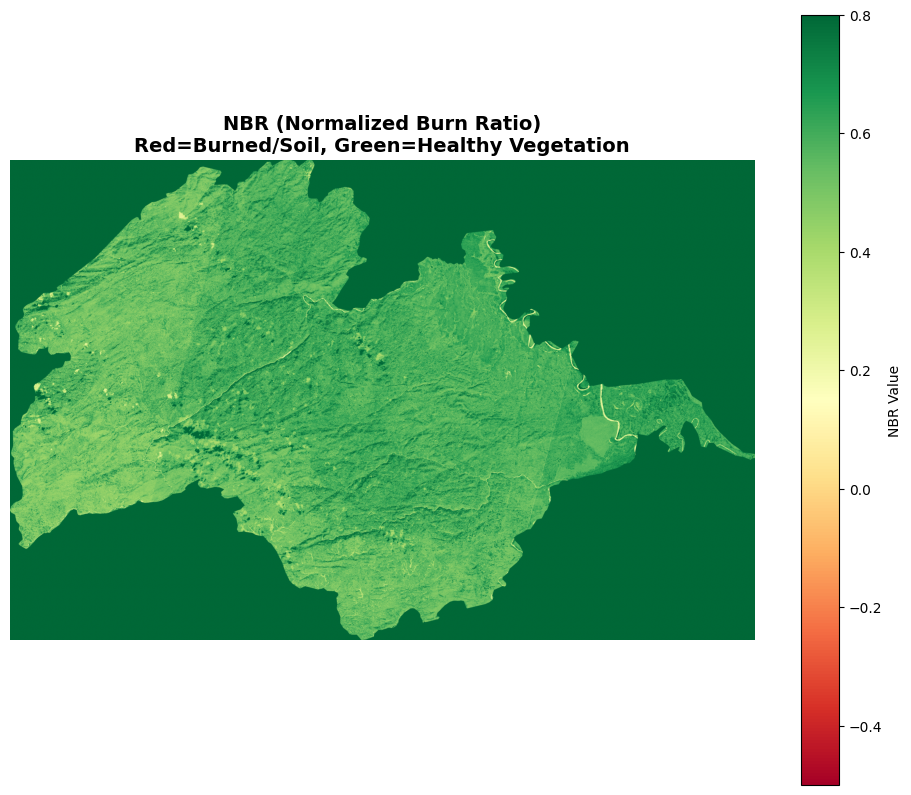

Final Stats: Min=0.127, Max=214748.359


In [ ]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import copy

# ==========================================
# 1. SETUP PATH
# ==========================================
file_path = "/content/NBR,2021.tif"

# ==========================================
# 2. LOAD & AUTO-FIX DATA
# ==========================================
with rasterio.open(file_path) as src:
    data = src.read(1)

    # DEBUG: Print stats to check for scaling issues
    print(f"Raw Data Stats -> Min: {np.nanmin(data):.2f}, Max: {np.nanmax(data):.2f}")

    # FIX 1: Auto-detect large integer scaling (e.g. 5000 instead of 0.5)
    if np.nanmax(data) > 100:
        print("⚠ Detected integer scaling. Dividing by 10,000...")
        data = data / 10000.0

    # FIX 2: Handle NoData (Mask out infinite or huge negative numbers)
    data = np.where(data < -100, np.nan, data)
    data_masked = np.ma.masked_invalid(data)

    # Clip range for better contrast
    # NBR usually ranges from -1 to 1.
    # We focus on -0.5 (Burned/Water) to 0.8 (Healthy Veg)
    data_masked = np.clip(data_masked, -0.5, 1.0)

    # ==========================================
    # 3. PLOT
    # ==========================================
    fig, ax = plt.subplots(figsize=(12, 10))

    # Force pure white background
    fig.patch.set_facecolor('white')
    ax.set_facecolor('white')

    # Setup Colormap: Red (Burned/Soil) -> Green (Healthy Vegetation)
    my_cmap = copy.copy(plt.cm.RdYlGn)
    my_cmap.set_bad(color='white') # Make empty pixels white

    # Plot
    im = ax.imshow(data_masked, cmap=my_cmap, vmin=-0.5, vmax=0.8)

    ax.set_title("NBR (Normalized Burn Ratio)\nRed=Burned/Soil, Green=Healthy Vegetation",
                 fontsize=14, fontweight='bold')

    plt.colorbar(im, ax=ax, label="NBR Value")
    ax.axis('off')

    plt.show()

    # Print final stats
    print(f"Final Stats: Min={np.nanmin(data):.3f}, Max={np.nanmax(data):.3f}")

Raw Data Stats -> Min: 2109.00, Max: 2147483648.00
⚠ Detected integer scaling. Dividing by 10,000...


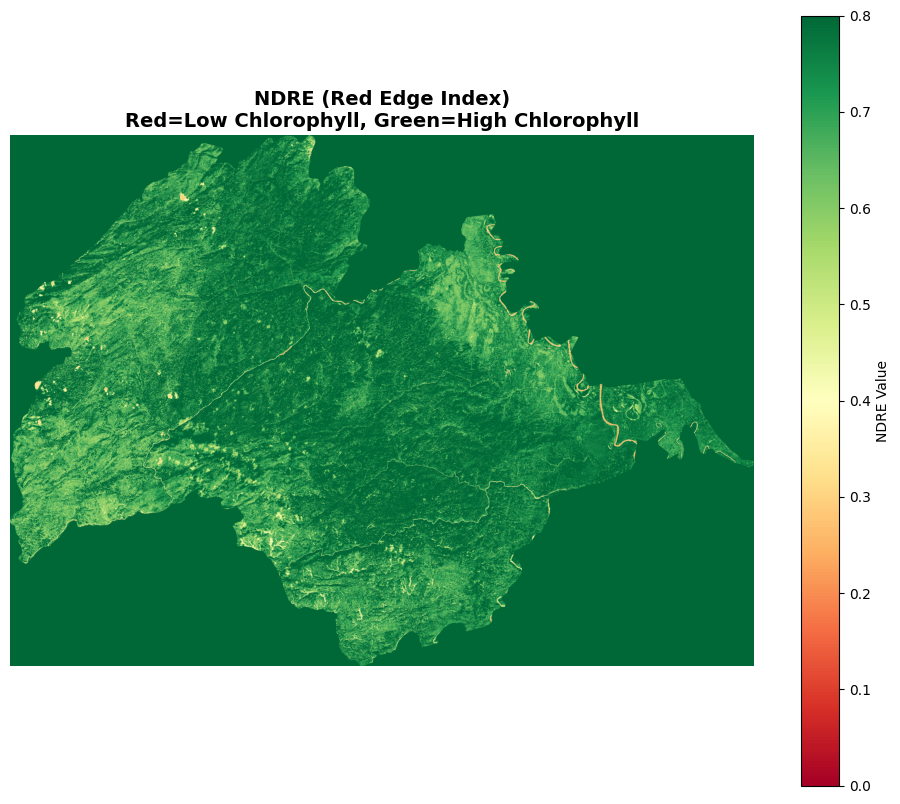

Final Stats: Min=0.211, Max=214748.359


In [ ]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import copy

# ==========================================
# 1. SETUP PATH
# ==========================================
file_path = "/content/NDRE2021.tif"

# ==========================================
# 2. LOAD & AUTO-FIX DATA
# ==========================================
with rasterio.open(file_path) as src:
    data = src.read(1)

    # DEBUG: Print stats to check for integer scaling
    print(f"Raw Data Stats -> Min: {np.nanmin(data):.2f}, Max: {np.nanmax(data):.2f}")

    # FIX 1: Auto-detect large integers (e.g. 7000 instead of 0.7)
    if np.nanmax(data) > 100:
        print("⚠ Detected integer scaling. Dividing by 10,000...")
        data = data / 10000.0

    # FIX 2: Handle NoData
    data = np.where(data < -100, np.nan, data)
    data_masked = np.ma.masked_invalid(data)

    # NDRE Range: -1 to 1
    # We clip to 0.0 - 0.8 to highlight crop variation.
    data_masked = np.clip(data_masked, 0.0, 0.8)

    # ==========================================
    # 3. PLOT
    # ==========================================
    fig, ax = plt.subplots(figsize=(12, 10))

    # Force pure white background
    fig.patch.set_facecolor('white')
    ax.set_facecolor('white')

    # Setup Colormap: Red (Soil/Stress) -> Green (Healthy/Dense)
    my_cmap = copy.copy(plt.cm.RdYlGn)
    my_cmap.set_bad(color='white') # Make empty pixels white

    # Plot
    im = ax.imshow(data_masked, cmap=my_cmap, vmin=0, vmax=0.8)

    ax.set_title("NDRE (Red Edge Index)\nRed=Low Chlorophyll, Green=High Chlorophyll",
                 fontsize=14, fontweight='bold')

    plt.colorbar(im, ax=ax, label="NDRE Value")
    ax.axis('off')

    plt.show()

    # Print final stats
    print(f"Final Stats: Min={np.nanmin(data):.3f}, Max={np.nanmax(data):.3f}")

Raw Data Stats -> Min: 1753.50, Max: 2147483648.00
⚠ Detected integer scaling. Dividing by 10,000...


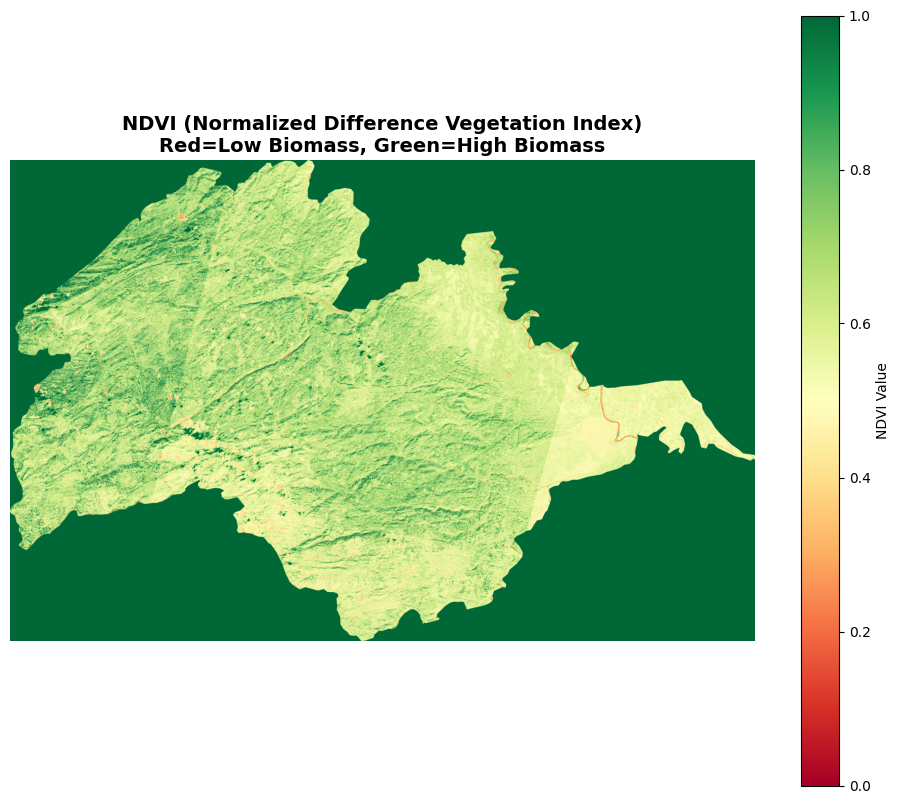

Final Stats: Min=0.175, Max=214748.359


In [ ]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import copy

# ==========================================
# 1. SETUP PATH
# ==========================================
# Note: Ensure the comma is correct in the filename based on your list
file_path = "/content/NDVI,2021.tif"

# ==========================================
# 2. LOAD & AUTO-FIX DATA
# ==========================================
with rasterio.open(file_path) as src:
    data = src.read(1)

    # DEBUG: Print stats to check for integer scaling
    print(f"Raw Data Stats -> Min: {np.nanmin(data):.2f}, Max: {np.nanmax(data):.2f}")

    # FIX 1: Auto-detect large integers (e.g. 8000 instead of 0.8)
    if np.nanmax(data) > 100:
        print("⚠ Detected integer scaling. Dividing by 10,000...")
        data = data / 10000.0

    # FIX 2: Handle NoData (Mask out infinite or huge negative numbers)
    # Convert values < -100 to NaN
    data = np.where(data < -100, np.nan, data)
    data_masked = np.ma.masked_invalid(data)

    # NDVI Standard Range: -1 to 1
    # We clip to 0.0 to 1.0 to focus on Vegetation vs. Soil
    data_masked = np.clip(data_masked, 0.0, 1.0)

    # ==========================================
    # 3. PLOT
    # ==========================================
    fig, ax = plt.subplots(figsize=(12, 10))

    # Force pure white background
    fig.patch.set_facecolor('white')
    ax.set_facecolor('white')

    # Setup Colormap: Red (Soil) -> Green (Healthy Veg)
    my_cmap = copy.copy(plt.cm.RdYlGn)
    my_cmap.set_bad(color='white') # Make empty pixels white

    # Plot
    im = ax.imshow(data_masked, cmap=my_cmap, vmin=0, vmax=1.0)

    ax.set_title("NDVI (Normalized Difference Vegetation Index)\nRed=Low Biomass, Green=High Biomass",
                 fontsize=14, fontweight='bold')

    plt.colorbar(im, ax=ax, label="NDVI Value")
    ax.axis('off')

    plt.show()

    # Print final stats
    print(f"Final Stats: Min={np.nanmin(data):.3f}, Max={np.nanmax(data):.3f}")

⏳ Processing Images...
🎯 Master Shape: (3144, 4871)
✅ Loaded: NDVI     | Range: 0.18 to 2.00
✅ Loaded: GNDVI    | Range: 0.20 to 2.00
✅ Loaded: EVI      | Range: -99.90 to 3229.44
✅ Loaded: CLRE     | Range: -1.00 to 2.50
✅ Loaded: NBR      | Range: 0.13 to 2.00
✅ Loaded: NDWI     | Range: 0.16 to 2.00
✅ Loaded: LWSI     | Range: 0.22 to 2.00
✅ Loaded: MSI      | Range: 0.00 to 1.59
✅ Loaded: MCARI    | Range: -0.01 to 0.37
✅ Loaded: NDRE     | Range: 0.22 to 2.00

🎨 Generating 12-Panel Grid...


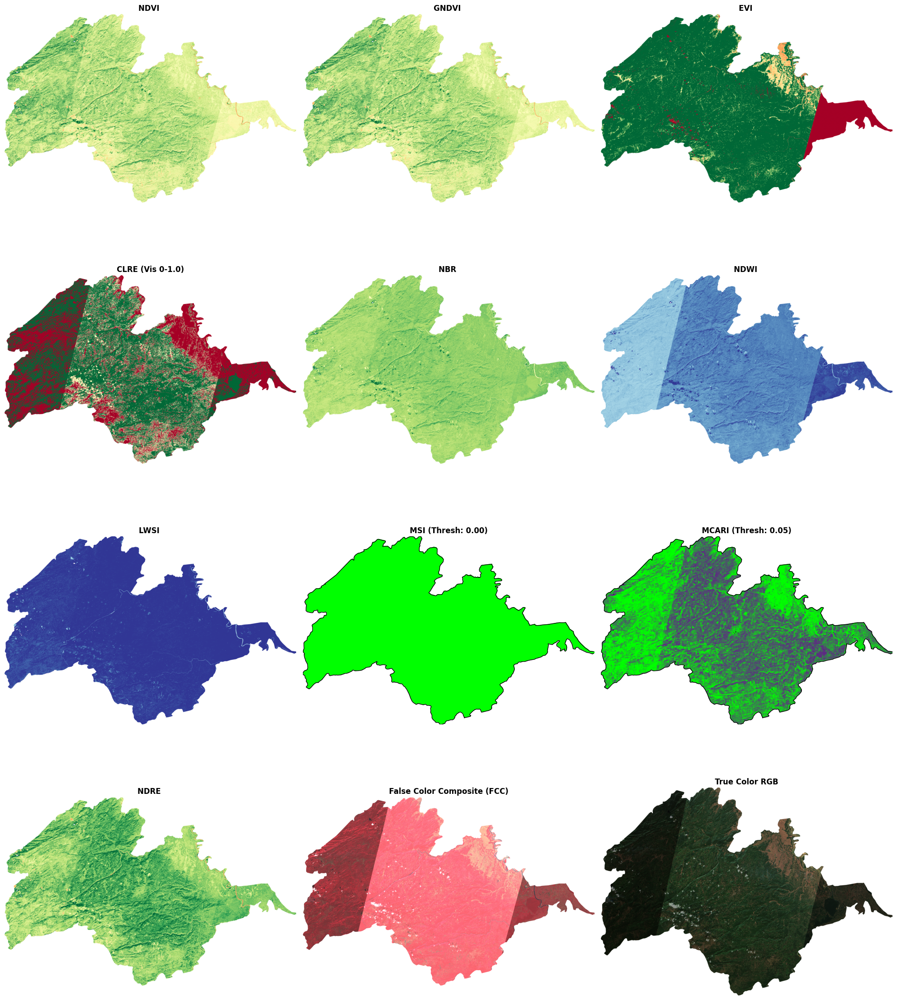

In [ ]:
import rasterio
from rasterio.enums import Resampling
from rasterio.warp import reproject
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import copy
import os

# ==========================================
# 1. SETUP FILE PATHS
# ==========================================
master_path = "/content/NDVI,2021.tif"
fcc_path = "/content/FCC,2021.tif"        # NEW: FCC Path
rgb_path = "/content/KarbiAnglong2021.tif" # RGB Path

# Indices to align (Single Band)
index_files = {
    "NDVI":  "/content/NDVI,2021.tif",
    "GNDVI": "/content/GNDVI2021.tif",
    "EVI":   "/content/EVI,2021.tif",
    "CLRE":  "/content/CLRE2021.tif",
    "NBR":   "/content/NBR,2021.tif",
    "NDWI":  "/content/NDWI.tif",
    "LWSI":  "/content/LWSI,2021.tif",
    "MSI":   "/content/MSI,2021.tif",
    "MCARI": "/content/MCARI2021.tif",
    "NDRE":  "/content/NDRE2021.tif"
}

# ==========================================
# 2. ALIGNMENT FUNCTION (Robust Percentile Scaling)
# ==========================================
def align_and_load(files, reference_path):
    aligned_data = {}
    if not os.path.exists(reference_path):
        print("❌ CRITICAL ERROR: Master reference file missing!")
        return {}

    with rasterio.open(reference_path) as ref_src:
        ref_shape = (ref_src.height, ref_src.width)
        ref_transform = ref_src.transform
        ref_crs = ref_src.crs
        print(f"🎯 Master Shape: {ref_shape}")

    for name, path in files.items():
        if not os.path.exists(path):
            print(f"⚠️ Missing: {name}")
            continue

        with rasterio.open(path) as src:
            data = src.read(1)

            # 1. Resize if needed
            if src.shape != ref_shape:
                new_data = np.zeros(ref_shape, dtype=np.float32)
                reproject(source=rasterio.band(src, 1), destination=new_data,
                          src_transform=src.transform, src_crs=src.crs,
                          dst_transform=ref_transform, dst_crs=ref_crs,
                          resampling=Resampling.bilinear)
                data = new_data
            else:
                data = data.astype(np.float32)

            # 2. Fix NoData
            data = np.where((data < -100) | (data > 20000), np.nan, data)

            # 3. SMART SCALING (Check 98th Percentile)
            valid_pixels = data[~np.isnan(data)]
            if len(valid_pixels) > 0:
                p98 = np.percentile(valid_pixels, 98)
                if p98 > 100: data = data / 10000.0

            aligned_data[name] = data
            print(f"✅ Loaded: {name:<8} | Range: {np.nanmin(data):.2f} to {np.nanmax(data):.2f}")

    return aligned_data

# ==========================================
# 3. EXECUTE LOADING
# ==========================================
print("⏳ Processing Images...")
final_dataset = align_and_load(index_files, master_path)

# ==========================================
# 4. VISUALIZATION
# ==========================================
print("\n🎨 Generating 12-Panel Grid...")
fig, axes = plt.subplots(4, 3, figsize=(20, 24))
axes = axes.flatten()
fig.patch.set_facecolor('white')

# ORDER: 10 Indices + 1 FCC + 1 RGB
plot_order = ["NDVI", "GNDVI", "EVI", "CLRE", "NBR", "NDWI",
              "LWSI", "MSI", "MCARI", "NDRE", "FCC"] # FCC is 11th

for i, name in enumerate(plot_order):
    ax = axes[i]
    ax.set_facecolor('white')

    # ---------------------------------------------------------
    # SPECIAL HANDLER FOR FCC (Load 3 bands directly)
    # ---------------------------------------------------------
    if name == "FCC":
        if os.path.exists(fcc_path):
            with rasterio.open(fcc_path) as src:
                # Read 3 bands
                if src.count >= 3:
                    r, g, b = src.read(1), src.read(2), src.read(3)
                    fcc_img = np.dstack((r, g, b)).astype(float)

                    # Auto-Brightness
                    if np.nanmax(fcc_img) > 255: fcc_img /= 3000.0
                    elif np.nanmax(fcc_img) > 1: fcc_img /= 255.0

                    fcc_img = np.clip(fcc_img, 0, 1)
                    ax.imshow(fcc_img)
                    ax.set_title("False Color Composite (FCC)", fontweight='bold', fontsize=12)
                else:
                    ax.text(0.5, 0.5, "FCC has < 3 Bands", ha='center')
        else:
            ax.text(0.5, 0.5, "FCC File Missing", ha='center', color='red')
        ax.axis('off')
        continue # Skip the rest of the loop for FCC

    # ---------------------------------------------------------
    # STANDARD INDICES HANDLER
    # ---------------------------------------------------------
    if name not in final_dataset:
        ax.text(0.5, 0.5, "Missing", ha='center', color='red')
        ax.axis('off'); continue

    data = final_dataset[name]
    cmap, norm, vmin, vmax = None, None, None, None
    data_plot = data
    title_extra = ""

    if name == "MSI":
        data_plot = np.clip(data, 0, 4.0)
        auto_threshold = np.nanmedian(data_plot)
        colors = ['#5e2a84', '#00ff00'] # Purple->Green
        cmap = mcolors.ListedColormap(colors)
        cmap.set_bad('white')
        bounds = [0, auto_threshold, 4.0]
        norm = mcolors.BoundaryNorm(bounds, cmap.N)
        title_extra = f"(Thresh: {auto_threshold:.2f})"

    elif name == "CLRE":
        data_plot = np.clip(data, 0, 1.5)
        vmin, vmax = 0, 1.0
        cmap = copy.copy(plt.cm.RdYlGn)
        cmap.set_bad('white')
        title_extra = "(Vis 0-1.0)"

    elif name == "EVI":
        data_plot = np.clip(data, -0.2, 1.0)
        vmin, vmax = 0, 0.8
        cmap = copy.copy(plt.cm.RdYlGn)
        cmap.set_bad('white')

    elif name == "MCARI":
        p2, p98 = np.nanpercentile(data, [2, 98])
        data_plot = np.clip(data, p2, p98)
        auto_threshold = np.nanmean(data_plot)
        colors = ['#00ff00', '#5e2a84'] # Green->Purple
        cmap = mcolors.ListedColormap(colors)
        cmap.set_bad('white')
        bounds = [p2, auto_threshold, p98]
        norm = mcolors.BoundaryNorm(bounds, cmap.N)
        title_extra = f"(Thresh: {auto_threshold:.2f})"

    elif name in ["NDWI", "LWSI"]:
        cmap = copy.copy(plt.cm.RdYlBu)
        cmap.set_bad('white')
        vmin, vmax = -0.6, 0.6
    else: # NDVI, GNDVI, NBR, NDRE
        cmap = copy.copy(plt.cm.RdYlGn)
        cmap.set_bad('white')
        vmin, vmax = -0.5 if name == "NBR" else 0, 1.0

    data_masked = np.ma.masked_invalid(data_plot)
    im = ax.imshow(data_masked, cmap=cmap, norm=norm, vmin=vmin, vmax=vmax)
    ax.set_title(f"{name} {title_extra}", fontweight='bold', fontsize=12)

    if name in ["MSI", "MCARI"]:
        mask = (~np.ma.getmask(data_masked)).astype(int)
        if np.any(mask): ax.contour(mask, levels=[0.5], colors='black', linewidths=1)

    ax.axis('off')

# ---------------------------------------------------------
# 12TH PANEL: TRUE COLOR RGB
# ---------------------------------------------------------
ax_rgb = axes[11]
ax_rgb.set_facecolor('white')

if os.path.exists(rgb_path):
    with rasterio.open(rgb_path) as src:
        if src.count >= 3:
            r, g, b = src.read(1), src.read(2), src.read(3)
            rgb = np.dstack((r, g, b)).astype(float)
            if np.nanmax(rgb) > 255: rgb /= 3000.0
            elif np.nanmax(rgb) > 1: rgb /= 255.0
            rgb = np.clip(rgb, 0, 1)
            ax_rgb.imshow(rgb)
            ax_rgb.set_title("True Color RGB", fontweight='bold', fontsize=12)
        else:
            ax_rgb.text(0.5, 0.5, "Not RGB", ha='center')
else:
    ax_rgb.text(0.5, 0.5, "File Missing", ha='center', color='red')

ax_rgb.axis('off')

plt.tight_layout()
plt.show()

--- Statistics (Resolution: 20m x 29m) ---
   Class Value  Pixel Count  Percentage (%)  Area (Sq Km)
0         -1.0        20201            0.26       11.7166
1         -0.5         6156            0.08        3.5705
2          0.0      2576097           33.45     1494.1363
3          0.5      1149175           14.92      666.5215
4          1.0      3894223           50.57     2258.6493
5          1.5        47674            0.62       27.6509
6          2.0         7242            0.09        4.2004
7          2.5            4            0.00        0.0023


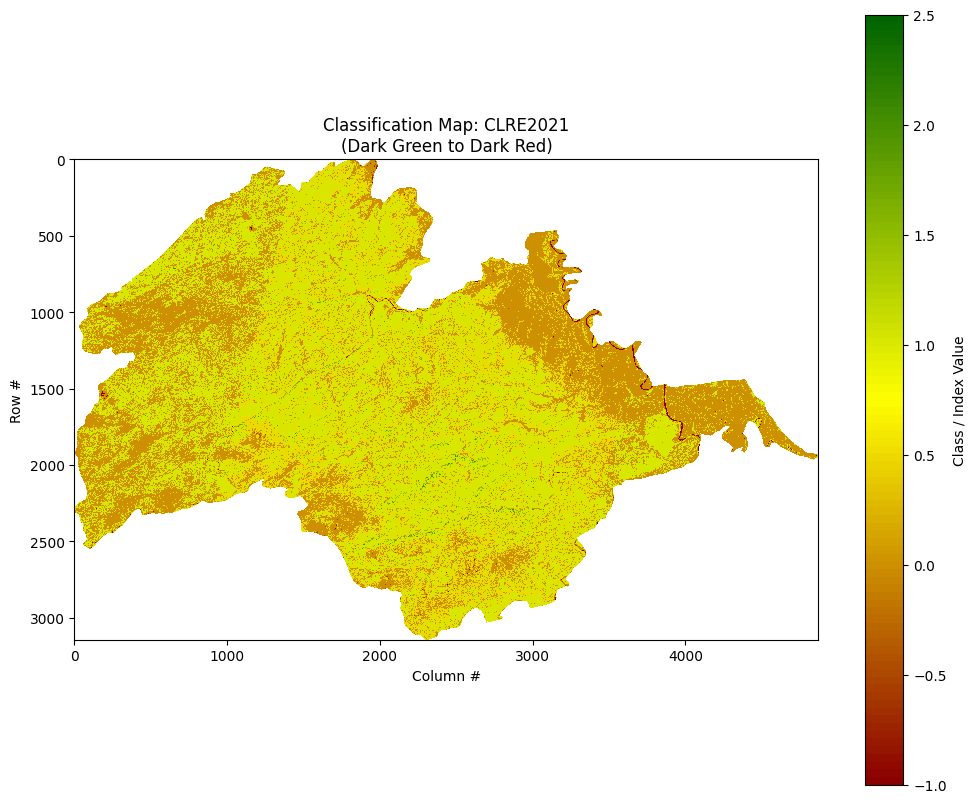

In [ ]:
# Install rasterio if not already installed
# !pip install rasterio

import rasterio
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap

# 1. Configuration
file_path = '/content/CLRE2021.tif'
pixel_width = 20   # meters
pixel_height = 29  # meters

# Calculate area of a single pixel in Square Kilometers
pixel_area_sq_km = (pixel_width * pixel_height) / 1e6

try:
    with rasterio.open(file_path) as src:
        # Read the first band
        data = src.read(1)
        nodata = src.nodata

        # Handle NoData (background)
        if nodata is not None:
            valid_pixels = data[data != nodata]
            # Create a mask for visualization
            data_vis = np.ma.masked_where(data == nodata, data)
        else:
            valid_pixels = data.flatten()
            data_vis = data

    # 2. Statistics Calculation
    classes, counts = np.unique(valid_pixels, return_counts=True)
    total_pixels = counts.sum()

    # Calculate Percentage and Area
    percentages = (counts / total_pixels) * 100
    areas = counts * pixel_area_sq_km

    # Create Summary Table
    df = pd.DataFrame({
        'Class Value': classes,
        'Pixel Count': counts,
        'Percentage (%)': percentages.round(2),
        'Area (Sq Km)': areas.round(4)
    })

    print(f"--- Statistics (Resolution: {pixel_width}m x {pixel_height}m) ---")
    print(df)

    # 3. Visualization with Custom Colormap

    # Define the color ramp: Dark Green -> Yellow -> Dark Red
    # You can remove 'yellow' if you want a strict 2-color gradient
    colors = ['darkred', 'yellow', 'darkgreen']
    cmap_custom = LinearSegmentedColormap.from_list('red_to_green', colors, N=100)

    plt.figure(figsize=(12, 10))

    # Apply the custom colormap
    plt.imshow(data_vis, cmap=cmap_custom, interpolation='nearest')

    plt.colorbar(label='Class / Index Value')
    plt.title(f'Classification Map: CLRE2021\n(Dark Green to Dark Red)')
    plt.xlabel('Column #')
    plt.ylabel('Row #')
    plt.show()

except FileNotFoundError:
    print(f"Error: Could not find file at {file_path}")
except Exception as e:
    print(f"An error occurred: {e}")

--- MSI Stress Analysis Statistics ---
Threshold used: 1.0
              Category  Pixel Count  Percentage (%)  Area (Sq Km)
0    Healthy (Low MSI)      7750781           100.0       4495.45
1  Stressed (High MSI)            2             0.0          0.00
----------------------------------------


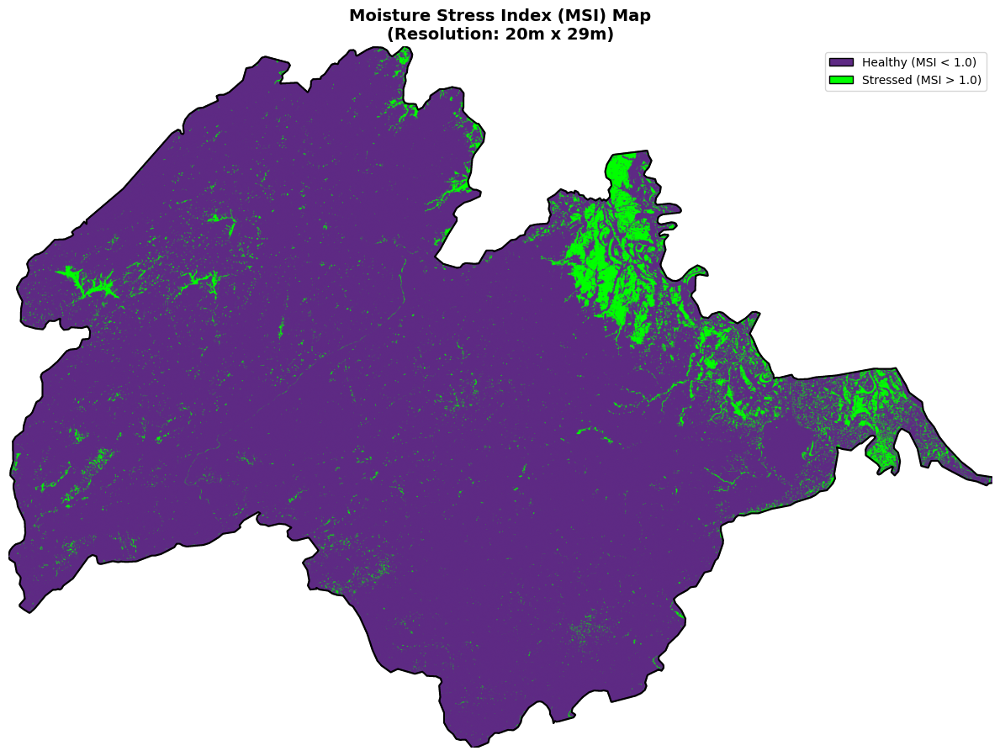

In [ ]:
import rasterio
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# ==========================================
# 1. CONFIGURATION
# ==========================================
file_path = "/content/MSI,2021.tif"  # Note: double-check if your file has a comma or not
pixel_width = 20   # meters
pixel_height = 29  # meters

# Threshold: MSI values > 1.0 usually indicate water stress
msi_threshold = 1.0

# Area of one pixel in Sq Km
pixel_area_sq_km = (pixel_width * pixel_height) / 1e6

try:
    with rasterio.open(file_path) as src:
        # Read data
        data = src.read(1)
        nodata = src.nodata

        # Mask NoData (background)
        if nodata is not None:
            data_masked = np.ma.masked_where(data == nodata, data)
            valid_pixels = data[data != nodata]
        else:
            # Fallback: assume 0 is background if not defined
            data_masked = np.ma.masked_where(data == 0, data)
            valid_pixels = data[data != 0]

    # ==========================================
    # 2. STATISTICS (Healthy vs Stressed)
    # ==========================================
    # Classify pixels based on threshold
    # Healthy (<= 1.0) and Stressed (> 1.0)
    count_healthy = np.sum(valid_pixels <= msi_threshold)
    count_stressed = np.sum(valid_pixels > msi_threshold)
    total_pixels = count_healthy + count_stressed

    # Create Data Table
    stats_data = {
        'Category': ['Healthy (Low MSI)', 'Stressed (High MSI)'],
        'Pixel Count': [count_healthy, count_stressed],
        'Percentage (%)': [
            (count_healthy / total_pixels) * 100,
            (count_stressed / total_pixels) * 100
        ],
        'Area (Sq Km)': [
            count_healthy * pixel_area_sq_km,
            count_stressed * pixel_area_sq_km
        ]
    }

    df = pd.DataFrame(stats_data)
    print("--- MSI Stress Analysis Statistics ---")
    print(f"Threshold used: {msi_threshold}")
    print(df.round(2))
    print("-" * 40)

    # ==========================================
    # 3. VISUALIZATION (Purple/Green + Border)
    # ==========================================
    fig, ax = plt.subplots(figsize=(12, 10))
    ax.set_facecolor('white')

    # Define Colors: Purple for Healthy (Low), Green for Stressed (High)
    colors = ['#5e2a84', '#00ff00']
    cmap_custom = mcolors.ListedColormap(colors)

    # Define Boundaries:
    # 0 to 1.0 = Purple
    # 1.0 to 10.0 = Green (Assuming max value is < 10)
    bounds = [0.0, msi_threshold, 10.0]
    norm = mcolors.BoundaryNorm(bounds, cmap_custom.N)

    # Plot Image
    im = ax.imshow(data_masked, cmap=cmap_custom, norm=norm)

    # Add Black Contour Border
    # Create a binary mask (1 where data exists, 0 where background)
    valid_mask = (~np.ma.getmask(data_masked)).astype(int)
    if np.any(valid_mask):
        ax.contour(valid_mask, levels=[0.5], colors='black', linewidths=1.5)

    # Add Legend / Colorbar
    # We use a custom legend because it's discrete (2 categories)
    from matplotlib.patches import Patch
    legend_elements = [
        Patch(facecolor='#5e2a84', edgecolor='black', label=f'Healthy (MSI < {msi_threshold})'),
        Patch(facecolor='#00ff00', edgecolor='black', label=f'Stressed (MSI > {msi_threshold})')
    ]
    ax.legend(handles=legend_elements, loc='upper right')

    ax.set_title(f"Moisture Stress Index (MSI) Map\n(Resolution: {pixel_width}m x {pixel_height}m)", fontsize=14, fontweight='bold')
    ax.axis('off')

    plt.tight_layout()
    plt.show()

except FileNotFoundError:
    print(f"Error: Could not find file at {file_path}")
except Exception as e:
    print(f"An error occurred: {e}")

In [ ]:
import rasterio
import numpy as np

file_path = "/content/MSI,2021.tif"

with rasterio.open(file_path) as src:
    data = src.read(1)
    # Filter out NoData (assuming 0 is background)
    valid_data = data[data != 0]

    print(f"Min Value: {valid_data.min()}")
    print(f"Max Value: {valid_data.max()}")
    print(f"Mean Value: {valid_data.mean()}")

Min Value: 0.5
Max Value: 65536.0
Mean Value: 60418.3125


--- MSI Stress Analysis (20m x 20m) ---
              Category  Pixel Count  Percentage (%)  Area (Sq Km)
0    Healthy (Low MSI)       650799         99.9997      260.3196
1  Stressed (High MSI)            2          0.0003        0.0008


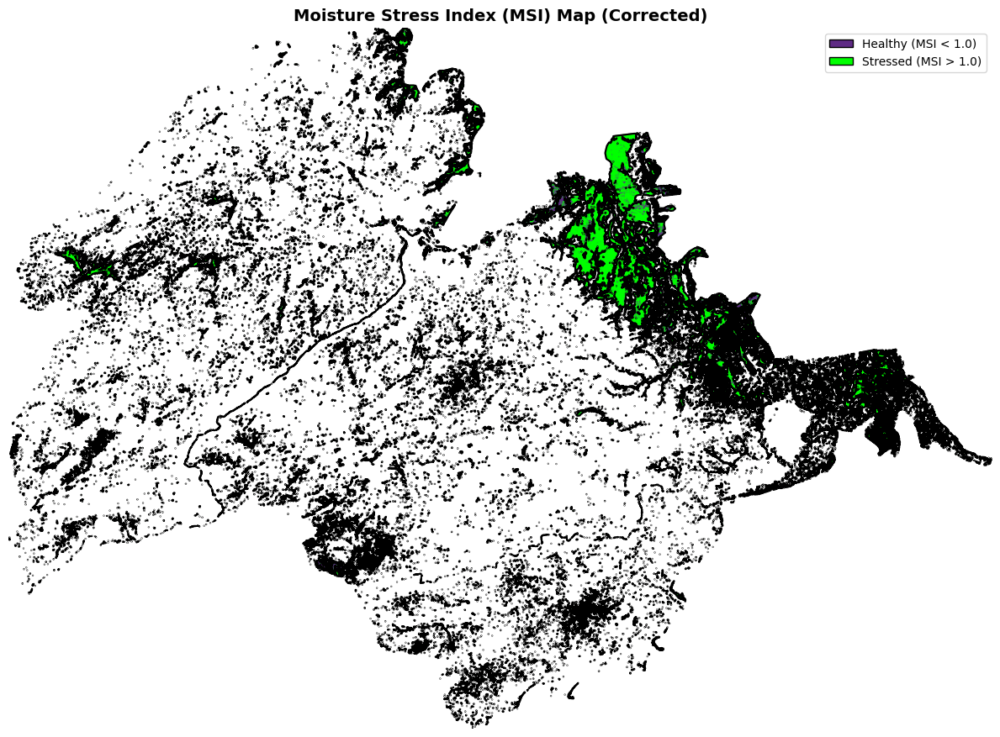

In [ ]:
import rasterio
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from matplotlib.patches import Patch

# ==========================================
# 1. CONFIGURATION
# ==========================================
file_path = "/content/MSI,2021.tif"
pixel_width = 20   # meters
pixel_height = 20  # meters
msi_threshold = 1.0

# Calculate area of a single pixel in Square Kilometers
pixel_area_sq_km = (pixel_width * pixel_height) / 1e6

try:
    with rasterio.open(file_path) as src:
        data = src.read(1)

        # --- CRITICAL FIX IS HERE ---
        # 1. Mask standard NoData (usually 0)
        # 2. Mask the 16-bit NoData value (65536 or close to it)
        # We mask anything greater than 100, because real MSI is rarely above 5 or 10.
        mask_condition = (data == 0) | (data > 100)

        data_masked = np.ma.masked_where(mask_condition, data)

        # Get only valid pixels for statistics
        valid_pixels = data[~mask_condition]

    # ==========================================
    # 2. STATISTICS
    # ==========================================
    if valid_pixels.size > 0:
        count_healthy = np.sum(valid_pixels <= msi_threshold)
        count_stressed = np.sum(valid_pixels > msi_threshold)
        total_pixels = count_healthy + count_stressed

        stats_data = {
            'Category': ['Healthy (Low MSI)', 'Stressed (High MSI)'],
            'Pixel Count': [count_healthy, count_stressed],
            'Percentage (%)': [
                (count_healthy / total_pixels) * 100,
                (count_stressed / total_pixels) * 100
            ],
            'Area (Sq Km)': [
                count_healthy * pixel_area_sq_km,
                count_stressed * pixel_area_sq_km
            ]
        }

        df = pd.DataFrame(stats_data)
        print(f"--- MSI Stress Analysis ({pixel_width}m x {pixel_height}m) ---")
        print(df.round(4))
    else:
        print("Error: No valid pixels found after masking high values!")

    # ==========================================
    # 3. VISUALIZATION
    # ==========================================
    fig, ax = plt.subplots(figsize=(12, 10))
    ax.set_facecolor('white')

    colors = ['#5e2a84', '#00ff00']
    cmap_custom = mcolors.ListedColormap(colors)

    # Values 0 to 1.0 = Purple, 1.0 to 10 = Green
    bounds = [0.0, msi_threshold, 10.0]
    norm = mcolors.BoundaryNorm(bounds, cmap_custom.N)

    im = ax.imshow(data_masked, cmap=cmap_custom, norm=norm)

    # Add Black Contour
    valid_mask = (~np.ma.getmask(data_masked)).astype(int)
    if np.any(valid_mask):
        ax.contour(valid_mask, levels=[0.5], colors='black', linewidths=1.5)

    # Legend
    legend_elements = [
        Patch(facecolor='#5e2a84', edgecolor='black', label=f'Healthy (MSI < {msi_threshold})'),
        Patch(facecolor='#00ff00', edgecolor='black', label=f'Stressed (MSI > {msi_threshold})')
    ]
    ax.legend(handles=legend_elements, loc='upper right')

    ax.set_title(f"Moisture Stress Index (MSI) Map (Corrected)", fontsize=14, fontweight='bold')
    ax.axis('off')
    plt.tight_layout()
    plt.show()

except FileNotFoundError:
    print(f"Error: Could not find file at {file_path}")
except Exception as e:
    print(f"An error occurred: {e}")

--- Data Inspection ---
Original Min: 1955.0
Original Max: 2147483648.0
Max valid value found: 35385.0
(!) Detected scaled integer values. Scaling down by 10,000...

--- GNDVI Statistics (Resolution: 20m x 20m) ---
        GNDVI Category  Pixel Count  Percentage (%)  Area (Sq Km)
0       Non-Veg (<0.2)            1            0.00        0.0004
1  Low Vigor (0.2-0.4)        93733            1.22       37.4932
2   Moderate (0.4-0.6)      2836168           36.83     1134.4672
3       High (0.6-0.8)      3865267           50.19     1546.1068
4     Very High (>0.8)       905603           11.76      362.2412
--------------------------------------------------


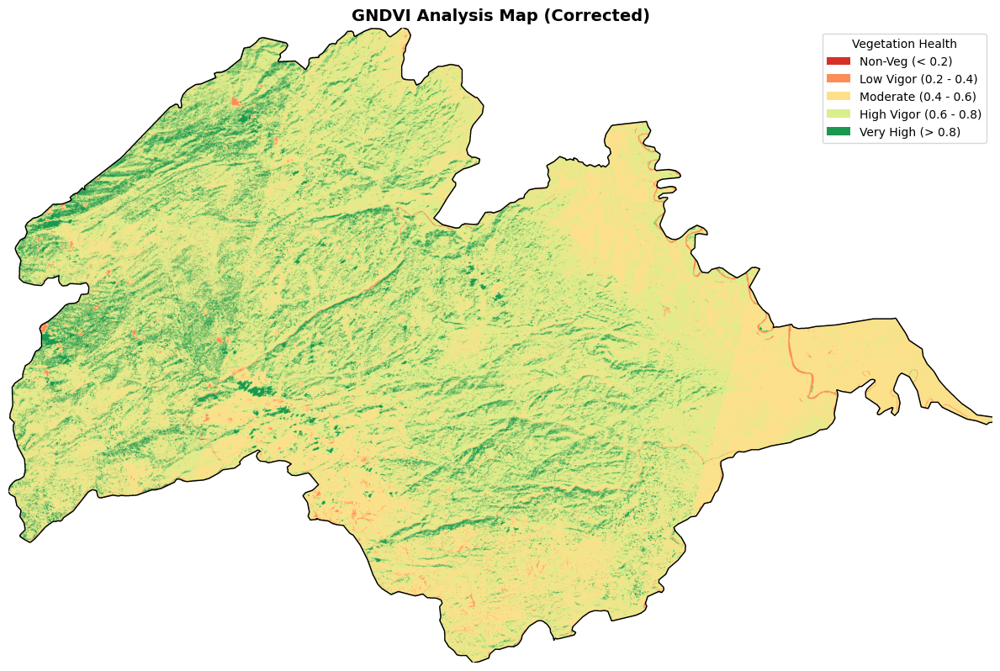

In [ ]:
import rasterio
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from matplotlib.patches import Patch

# ==========================================
# 1. CONFIGURATION
# ==========================================
file_path = "/content/GNDVI2021.tif"
pixel_width = 20   # meters
pixel_height = 20  # meters

# Calculate pixel area (20m * 20m = 400 sqm = 0.0004 sq km)
pixel_area_sq_km = (pixel_width * pixel_height) / 1e6

try:
    with rasterio.open(file_path) as src:
        # Read the first band
        data = src.read(1)
        nodata = src.nodata

        print(f"--- Data Inspection ---")
        print(f"Original Min: {np.nanmin(data)}")
        print(f"Original Max: {np.nanmax(data)}")

        # --- DATA CLEANING STEP ---
        # 1. Mask huge NoData values (common in GeoTIFFs, e.g., 2.14 billion)
        #    We mask anything > 1,000,000 as it's definitely not valid GNDVI
        mask_huge = (data > 1000000)

        # 2. Mask standard NoData if defined
        if nodata is not None:
            mask_nodata = (data == nodata)
        else:
            mask_nodata = (data == 0) # Fallback

        # Combine masks
        final_mask = mask_huge | mask_nodata
        data_masked = np.ma.masked_where(final_mask, data)

        # 3. AUTO-SCALING
        # Check the max of the valid data (not the huge NoData stuff)
        valid_max = np.ma.max(data_masked)
        print(f"Max valid value found: {valid_max}")

        if valid_max > 2.0:
            print("(!) Detected scaled integer values. Scaling down by 10,000...")
            data_masked = data_masked / 10000.0

        # Get valid pixels for statistics
        valid_pixels = data_masked.compressed()

    # ==========================================
    # 2. STATISTICS (5-Class Analysis)
    # ==========================================
    if valid_pixels.size > 0:
        # Standard GNDVI Classes
        bins = [-np.inf, 0.2, 0.4, 0.6, 0.8, np.inf]
        labels = ['Non-Veg (<0.2)', 'Low Vigor (0.2-0.4)', 'Moderate (0.4-0.6)', 'High (0.6-0.8)', 'Very High (>0.8)']

        # Classify pixels
        categories = np.digitize(valid_pixels, bins)

        # Count pixels per category
        counts = [np.sum(categories == i) for i in range(1, len(bins))]
        total_pixels = sum(counts)

        # Calculate Percentage and Area
        percentages = [(c / total_pixels) * 100 for c in counts]
        areas = [c * pixel_area_sq_km for c in counts]

        df = pd.DataFrame({
            'GNDVI Category': labels,
            'Pixel Count': counts,
            'Percentage (%)': np.round(percentages, 2),
            'Area (Sq Km)': np.round(areas, 4)
        })

        print("\n--- GNDVI Statistics (Resolution: 20m x 20m) ---")
        print(df)
        print("-" * 50)
    else:
        print("Error: No valid data found.")
        data_masked = None

    # ==========================================
    # 3. VISUALIZATION
    # ==========================================
    if data_masked is not None:
        fig, ax = plt.subplots(figsize=(12, 10))
        ax.set_facecolor('white')

        # Custom Colors: Red -> Orange -> Yellow -> Light Green -> Dark Green
        colors = ['#d73027', '#fc8d59', '#fee08b', '#d9ef8b', '#1a9850']
        cmap_custom = mcolors.ListedColormap(colors)

        # Bounds corresponding to the bins: <0.2, 0.2-0.4, 0.4-0.6, 0.6-0.8, >0.8
        # We define explicit boundaries for the 5 colors
        bounds = [-0.2, 0.2, 0.4, 0.6, 0.8, 1.0]

        # FIX: Removed extend='both' to match ncolors=5 with 5 bins
        norm = mcolors.BoundaryNorm(bounds, cmap_custom.N)

        im = ax.imshow(data_masked, cmap=cmap_custom, norm=norm)

        # Add Black Contour Border
        valid_mask = (~np.ma.getmask(data_masked)).astype(int)
        if np.any(valid_mask):
            ax.contour(valid_mask, levels=[0.5], colors='black', linewidths=1.0)

        # Legend
        legend_elements = [
            Patch(facecolor=colors[0], label='Non-Veg (< 0.2)'),
            Patch(facecolor=colors[1], label='Low Vigor (0.2 - 0.4)'),
            Patch(facecolor=colors[2], label='Moderate (0.4 - 0.6)'),
            Patch(facecolor=colors[3], label='High Vigor (0.6 - 0.8)'),
            Patch(facecolor=colors[4], label='Very High (> 0.8)')
        ]
        ax.legend(handles=legend_elements, loc='upper right', title="Vegetation Health")

        ax.set_title("GNDVI Analysis Map (Corrected)", fontsize=14, fontweight='bold')
        ax.axis('off')

        plt.tight_layout()
        plt.show()

except FileNotFoundError:
    print(f"Error: Could not find file at {file_path}")
except Exception as e:
    print(f"An error occurred: {e}")

--- Data Inspection ---
Original Min: 2230.0
Original Max: 2147483648.0
Max valid value found: 33025.0
(!) Detected scaled integer values. Scaling down by 10,000...

--- LWSI Statistics (Resolution: 20m x 20m) ---
           LWSI Category  Pixel Count  Percentage (%)  Area (Sq Km)
0       No Stress (<0.2)            0            0.00        0.0000
1   Low Stress (0.2-0.4)        58841            0.76       23.5364
2     Moderate (0.4-0.6)      1823675           23.68      729.4700
3  High Stress (0.6-0.8)      5161295           67.02     2064.5180
4          Severe (>0.8)       656961            8.53      262.7844
--------------------------------------------------


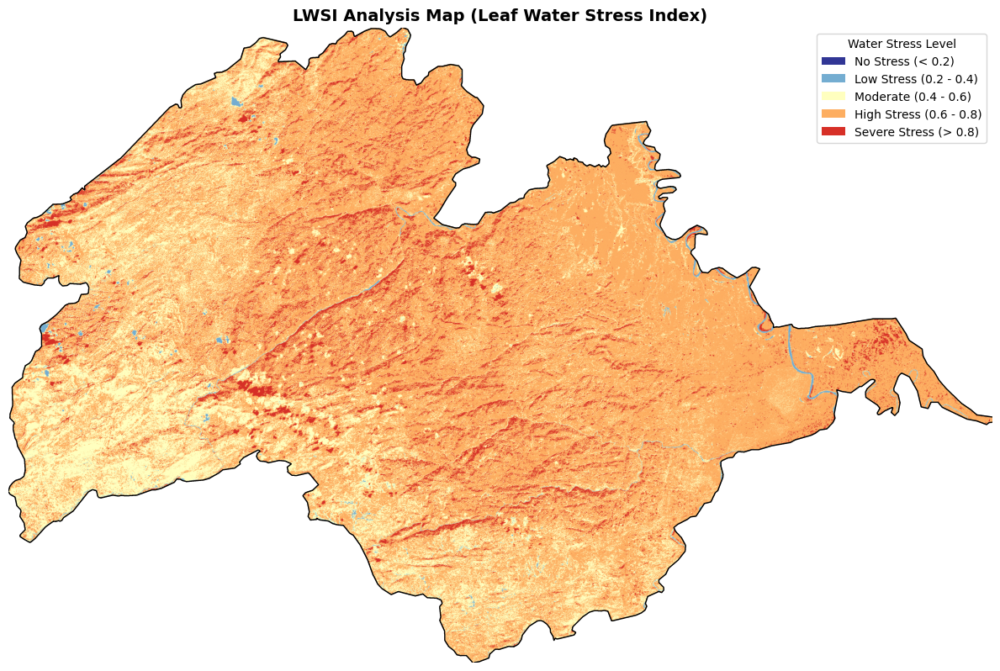

In [ ]:
import rasterio
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from matplotlib.patches import Patch

# ==========================================
# 1. CONFIGURATION
# ==========================================
file_path = "/content/LWSI,2021.tif"
pixel_width = 20   # meters
pixel_height = 20  # meters

# Calculate pixel area (20m * 20m = 0.0004 sq km)
pixel_area_sq_km = (pixel_width * pixel_height) / 1e6

try:
    with rasterio.open(file_path) as src:
        # Read the first band
        data = src.read(1)
        nodata = src.nodata

        print(f"--- Data Inspection ---")
        print(f"Original Min: {np.nanmin(data)}")
        print(f"Original Max: {np.nanmax(data)}")

        # --- DATA CLEANING ---
        # 1. Mask huge NoData values (> 1,000,000) common in this dataset
        mask_huge = (data > 1000000)

        # 2. Mask standard NoData if defined
        if nodata is not None:
            mask_nodata = (data == nodata)
        else:
            mask_nodata = (data == 0) # Fallback

        # Combine masks
        final_mask = mask_huge | mask_nodata
        data_masked = np.ma.masked_where(final_mask, data)

        # 3. AUTO-SCALING CHECK
        # LWSI is typically 0.0 to 1.0. If max > 2.0, it's likely scaled (e.g., 0-10000).
        valid_max = np.ma.max(data_masked)
        print(f"Max valid value found: {valid_max}")

        if valid_max > 2.0:
            print("(!) Detected scaled integer values. Scaling down by 10,000...")
            data_masked = data_masked / 10000.0

        # Get valid pixels for statistics
        valid_pixels = data_masked.compressed()

    # ==========================================
    # 2. STATISTICS (5-Class Stress Analysis)
    # ==========================================
    if valid_pixels.size > 0:
        # LWSI Classes (Leaf Water Stress Index)
        # 0.0 - 0.2 : No Stress (Healthy / Wet)
        # 0.2 - 0.4 : Low Stress
        # 0.4 - 0.6 : Moderate Stress
        # 0.6 - 0.8 : High Stress
        # > 0.8     : Severe Stress (Dry)
        bins = [-np.inf, 0.2, 0.4, 0.6, 0.8, np.inf]
        labels = ['No Stress (<0.2)', 'Low Stress (0.2-0.4)', 'Moderate (0.4-0.6)', 'High Stress (0.6-0.8)', 'Severe (>0.8)']

        # Classify pixels
        categories = np.digitize(valid_pixels, bins)

        # Count pixels per category
        counts = [np.sum(categories == i) for i in range(1, len(bins))]
        total_pixels = sum(counts)

        # Calculate Percentage and Area
        percentages = [(c / total_pixels) * 100 for c in counts]
        areas = [c * pixel_area_sq_km for c in counts]

        df = pd.DataFrame({
            'LWSI Category': labels,
            'Pixel Count': counts,
            'Percentage (%)': np.round(percentages, 2),
            'Area (Sq Km)': np.round(areas, 4)
        })

        print("\n--- LWSI Statistics (Resolution: 20m x 20m) ---")
        print(df)
        print("-" * 50)
    else:
        print("Error: No valid data found.")
        data_masked = None

    # ==========================================
    # 3. VISUALIZATION
    # ==========================================
    if data_masked is not None:
        fig, ax = plt.subplots(figsize=(12, 10))
        ax.set_facecolor('white')

        # Custom Colors: Blue (Wet/Healthy) -> Yellow -> Red (Dry/Stressed)
        # 'navy' -> 'blue' -> 'yellow' -> 'orange' -> 'darkred'
        colors = ['#313695', '#74add1', '#ffffbf', '#fdae61', '#d73027']
        cmap_custom = mcolors.ListedColormap(colors)

        # Define exact boundaries for the 5 colors
        bounds = [-0.2, 0.2, 0.4, 0.6, 0.8, 1.2]
        norm = mcolors.BoundaryNorm(bounds, cmap_custom.N)

        # Plot
        im = ax.imshow(data_masked, cmap=cmap_custom, norm=norm)

        # Add Black Contour Border
        valid_mask = (~np.ma.getmask(data_masked)).astype(int)
        if np.any(valid_mask):
            ax.contour(valid_mask, levels=[0.5], colors='black', linewidths=1.0)

        # Legend
        legend_elements = [
            Patch(facecolor=colors[0], label='No Stress (< 0.2)'),
            Patch(facecolor=colors[1], label='Low Stress (0.2 - 0.4)'),
            Patch(facecolor=colors[2], label='Moderate (0.4 - 0.6)'),
            Patch(facecolor=colors[3], label='High Stress (0.6 - 0.8)'),
            Patch(facecolor=colors[4], label='Severe Stress (> 0.8)')
        ]
        ax.legend(handles=legend_elements, loc='upper right', title="Water Stress Level")

        ax.set_title("LWSI Analysis Map (Leaf Water Stress Index)", fontsize=14, fontweight='bold')
        ax.axis('off')

        plt.tight_layout()
        plt.show()

except FileNotFoundError:
    print(f"Error: Could not find file at {file_path}")
except Exception as e:
    print(f"An error occurred: {e}")

In [ ]:
import rasterio
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from matplotlib.patches import Patch

# ==========================================
# 1. SETUP & CONFIGURATION
# ==========================================
file_path = "/content/MCARI2021.tif"
pixel_width = 20   # meters
pixel_height = 20  # meters

# Area of one pixel in Sq Km (20m * 20m = 0.0004 sq km)
pixel_area_sq_km = (pixel_width * pixel_height) / 1e6

# ==========================================
# 2. LOAD & CLEAN DATA
# ==========================================
try:
    with rasterio.open(file_path) as src:
        data = src.read(1)

        # 1. Handle NoData (Huge negatives or standard NoData)
        # We replace them with NaN so they don't mess up the math
        if src.nodata is not None:
             data = np.where(data == src.nodata, np.nan, data)
        data = np.where(data < -1000, np.nan, data) # Filter common "background" negatives

        # 2. Diagnostic Stats
        valid_data = data[~np.isnan(data)]
        if len(valid_data) == 0:
            raise ValueError("File is empty or contains only NoData.")

        print(f"📊 RAW STATS -> Min: {np.nanmin(data):.4f}, Max: {np.nanmax(data):.4f}, Mean: {np.nanmean(data):.4f}")

        # 3. Handle Integer Scaling (e.g. 0-10000 -> 0-1)
        if np.nanmax(data) > 10:
            print("⚠ Data values are large (>10). Dividing by 10,000 to normalize...")
            data = data / 10000.0
            valid_data = data[~np.isnan(data)] # Update valid data

        # 4. Determine Thresholds
        # We use the Mean as the cutoff between "Low" and "High"
        auto_threshold = np.nanmean(data)

        # For visualization only: Clip outliers (2nd to 98th percentile) to improve contrast
        vmin, vmax = np.nanpercentile(data, [2, 98])
        print(f"✂ Clipping display range to: {vmin:.4f} - {vmax:.4f}")
        print(f"⚖ Split Threshold (Mean): {auto_threshold:.4f}")

    # ==========================================
    # 3. STATISTICS (Area & Percentage)
    # ==========================================
    # Count pixels based on the threshold
    count_high = np.sum(valid_data >= auto_threshold)
    count_low = np.sum(valid_data < auto_threshold)
    total_valid = count_high + count_low

    # Create DataFrame
    df = pd.DataFrame({
        'Category': [f'High / Healthy (>{auto_threshold:.2f})', f'Low / Stressed (<{auto_threshold:.2f})'],
        'Pixel Count': [count_high, count_low],
        'Percentage (%)': [
            (count_high / total_valid) * 100,
            (count_low / total_valid) * 100
        ],
        'Area (Sq Km)': [
            count_high * pixel_area_sq_km,
            count_low * pixel_area_sq_km
        ]
    })

    print("\n--- MCARI Area Analysis (20m x 20m) ---")
    print(df.round(4))
    print("-" * 50)

    # ==========================================
    # 4. PLOTS (Histogram & Map)
    # ==========================================

    # --- A. Histogram ---
    fig_hist, ax_hist = plt.subplots(figsize=(10, 4))
    ax_hist.hist(valid_data.flatten(), bins=50, color='gray', range=(vmin, vmax), alpha=0.7)
    ax_hist.axvline(auto_threshold, color='red', linestyle='--', label=f'Threshold: {auto_threshold:.2f}')
    ax_hist.set_title("Data Distribution & Threshold")
    ax_hist.set_xlabel("MCARI Value")
    ax_hist.legend()
    plt.show()

    # --- B. The Map ---
    fig, ax = plt.subplots(figsize=(12, 10))
    fig.patch.set_facecolor('white')
    ax.set_facecolor('white')

    # Data Masking for Plot
    data_clipped = np.clip(data, vmin, vmax)
    data_masked = np.ma.masked_invalid(data_clipped)

    # Colors: Green (Low) -> Purple (High)
    # Note: In MCARI, High usually means Healthy.
    # This scheme makes Healthy = Purple, Stressed = Green (Matching your MSI logic).
    colors = ['#00ff00', '#5e2a84']
    cmap_custom = mcolors.ListedColormap(colors)
    cmap_custom.set_bad(color='white')

    # Map Boundaries
    bounds = [vmin, auto_threshold, vmax]
    norm = mcolors.BoundaryNorm(bounds, cmap_custom.N)

    # Plot
    im = ax.imshow(data_masked, cmap=cmap_custom, norm=norm)

    # Contour Border
    mask_valid_binary = (~np.ma.getmask(data_masked)).astype(int)
    if np.any(mask_valid_binary):
        ax.contour(mask_valid_binary, levels=[0.5], colors='black', linewidths=2)

    # Legend
    legend_elements = [
        Patch(facecolor=colors[1], edgecolor='black', label=f'High / Healthy (>{auto_threshold:.2f})'),
        Patch(facecolor=colors[0], edgecolor='black', label=f'Low / Stressed (<{auto_threshold:.2f})')
    ]
    ax.legend(handles=legend_elements, loc='lower right', fontsize=12, title="MCARI Status")

    ax.set_title(f"MCARI Analysis Map\n(Threshold: {auto_threshold:.2f})", fontsize=14, fontweight='bold')
    ax.axis('off')
    plt.tight_layout()
    plt.show()

except FileNotFoundError:
    print(f"❌ Error: File not found at {file_path}")
except Exception as e:
    print(f"❌ An error occurred: {e}")

In [ ]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import os
import copy

# ==========================================
# 1. SETUP PATH & CONSTANTS
# ==========================================
file_path = "/content/EVI,2021.tif"
pixel_resolution = 20  # 20 meters
pixel_area_km2 = (pixel_resolution * pixel_resolution) / 1_000_000

# ==========================================
# 2. LOAD DATA
# ==========================================
if not os.path.exists(file_path):
    print(f"❌ Error: File not found at {file_path}")
else:
    with rasterio.open(file_path) as src:
        data = src.read(1).astype(float)
        nodata = src.nodata

        # Mask NoData values
        if nodata is not None:
            data[data == nodata] = np.nan

        # Basic Data Cleaning (EVI is valid between -1 and 1)
        data[(data < -1) | (data > 1)] = np.nan
        valid_data = data[~np.isnan(data)]

        # ==========================================
        # 3. CLASSIFICATION & STATISTICS
        # ==========================================
        # Define class bins and labels
        bins = [-1, 0.2, 0.4, 0.6, 1.0]
        labels = ['Non-Veg / Sparse', 'Moderate Veg', 'High Veg', 'Dense Canopy']

        # Flatten data for calculation
        flat_data = valid_data.flatten()
        counts, _ = np.histogram(flat_data, bins=bins)

        total_pixels = len(flat_data)
        percentages = (counts / total_pixels) * 100
        areas_km2 = counts * pixel_area_km2

        # Create Summary Table
        df_stats = pd.DataFrame({
            "Class Range": ["< 0.2", "0.2 - 0.4", "0.4 - 0.6", "> 0.6"],
            "Description": labels,
            "Pixel Count": counts,
            "Percentage (%)": percentages.round(2),
            "Area (km2)": areas_km2.round(4)
        })

        # ==========================================
        # 4. VISUALIZATION
        # ==========================================
        fig, ax = plt.subplots(figsize=(12, 10))
        fig.patch.set_facecolor('white')

        # Setup Colormap
        my_cmap = copy.copy(plt.cm.RdYlGn)
        my_cmap.set_bad(color='white')

        # Masking nan values for display
        data_display = np.ma.masked_invalid(data)
        im = ax.imshow(data_display, cmap=my_cmap, vmin=0, vmax=0.8)

        ax.set_title("EVI (Enhanced Vegetation Index) - 2021\nAnalysis & Spatial Distribution",
                     fontsize=14, fontweight='bold')
        plt.colorbar(im, ax=ax, label="EVI Value", fraction=0.046, pad=0.04)
        ax.axis('off')

        plt.show()

        # Print the final stats table
        print("\n--- LAND COVER STATISTICS (Resolution: 20x20m) ---")
        print(df_stats.to_string(index=False))
        print(f"\nTotal Study Area: {df_stats['Area (km2)'].sum():.4f} km2")

In [ ]:
import rasterio
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from matplotlib.patches import Patch

# ==========================================
# 1. CONFIGURATION
# ==========================================
file_path = "/content/NBR,2021.tif"
# Adjust pixel size if necessary (e.g., 30m for Landsat, 10m/20m for Sentinel)
pixel_width = 20
pixel_height = 20

pixel_area_sq_km = (pixel_width * pixel_height) / 1e6

try:
    with rasterio.open(file_path) as src:
        data = src.read(1).astype('float32')
        nodata = src.nodata

        print(f"--- NBR Data Inspection ---")
        print(f"Original Min: {np.nanmin(data)}")
        print(f"Original Max: {np.nanmax(data)}")

        # --- DATA CLEANING ---
        # Mask huge NoData values and standard NoData
        mask_huge = (data > 1000000) | (data < -1000000)
        mask_nodata = (data == nodata) if nodata is not None else (data == 0)

        final_mask = mask_huge | mask_nodata | np.isnan(data)
        data_masked = np.ma.masked_where(final_mask, data)

        # --- AUTO-SCALING CHECK ---
        # NBR should be between -1 and 1. If max > 2, it's likely scaled by 1000 or 10000.
        valid_max = np.ma.max(data_masked)
        if valid_max > 2.0:
            scale_factor = 1000.0 if valid_max < 2000 else 10000.0
            print(f"(!) Scaled values detected. Dividing by {scale_factor}...")
            data_masked = data_masked / scale_factor

        valid_pixels = data_masked.compressed()

    # ==========================================
    # 2. STATISTICS (Burn Severity / Vegetation Health)
    # ==========================================
    if valid_pixels.size > 0:
        # Standard USGS NBR/dNBR Classification
        # Lower values = Burned/Stressed | Higher values = Healthy/Regrowth
        bins = [-np.inf, -0.1, 0.1, 0.27, 0.44, 0.66, np.inf]
        labels = [
            'Burned/Sparse (< -0.1)',
            'Non-burned (-0.1 to 0.1)',
            'Low Severity (0.1 to 0.27)',
            'Mod-Low Severity (0.27 to 0.44)',
            'Mod-High Severity (0.44 to 0.66)',
            'High Severity/Healthy (> 0.66)'
        ]

        categories = np.digitize(valid_pixels, bins[1:])

        counts = [np.sum(categories == i) for i in range(len(labels))]
        total_pixels = sum(counts)

        df = pd.DataFrame({
            'NBR Category': labels,
            'Pixel Count': counts,
            'Percentage (%)': np.round([(c / total_pixels) * 100 for c in counts], 2),
            'Area (Sq Km)': np.round([c * pixel_area_sq_km for c in counts], 4)
        })

        print("\n--- NBR Statistics ---")
        print(df)
        print("-" * 50)
    else:
        print("Error: No valid data found.")
        data_masked = None

    # ==========================================
    # 3. VISUALIZATION
    # ==========================================
    if data_masked is not None:
        fig, ax = plt.subplots(figsize=(12, 10))

        # Colors: Red (Burned) -> Yellow -> Green (Healthy)
        colors = ['#7e0000', '#ffffff', '#ffff00', '#ffaa00', '#00aa00', '#006400']
        cmap_custom = mcolors.ListedColormap(colors)

        # Define boundaries to match the bins
        norm = mcolors.BoundaryNorm(bins[1:-1] + [1.0], cmap_custom.N)

        im = ax.imshow(data_masked, cmap=cmap_custom, vmin=-0.5, vmax=1.0)

        # Legend
        legend_elements = [Patch(facecolor=colors[i], label=labels[i]) for i in range(len(labels))]
        ax.legend(handles=legend_elements, loc='upper right', title="NBR Classes")

        ax.set_title("NBR Analysis Map (Normalized Burn Ratio) - 2021", fontsize=14, fontweight='bold')
        ax.axis('off')
        plt.show()

except Exception as e:
    print(f"An error occurred: {e}")

--- NDRE Data Inspection ---
Original Min: 2109.0
Original Max: 2147483648.0
(!) Scaled values detected. Dividing by 10000.0...

--- NDRE Statistics (Resolution: 20m x 20m) ---
                          NDRE Category  Pixel Count  Percentage (%)  \
0           Bare Soil / Non-veg (< 0.2)            0            0.00   
1  Stressed / Low Chlorophyll (0.2-0.4)        43426            0.56   
2             Moderate Health (0.4-0.6)       527992            6.81   
3                 High Health (0.6-0.8)      4203985           54.24   
4              Very High Health (> 0.8)      2975380           38.39   

   Area (Sq Km)  
0        0.0000  
1       17.3704  
2      211.1968  
3     1681.5940  
4     1190.1520  
--------------------------------------------------
Statistics saved to 'ndre_stats_2021.csv'


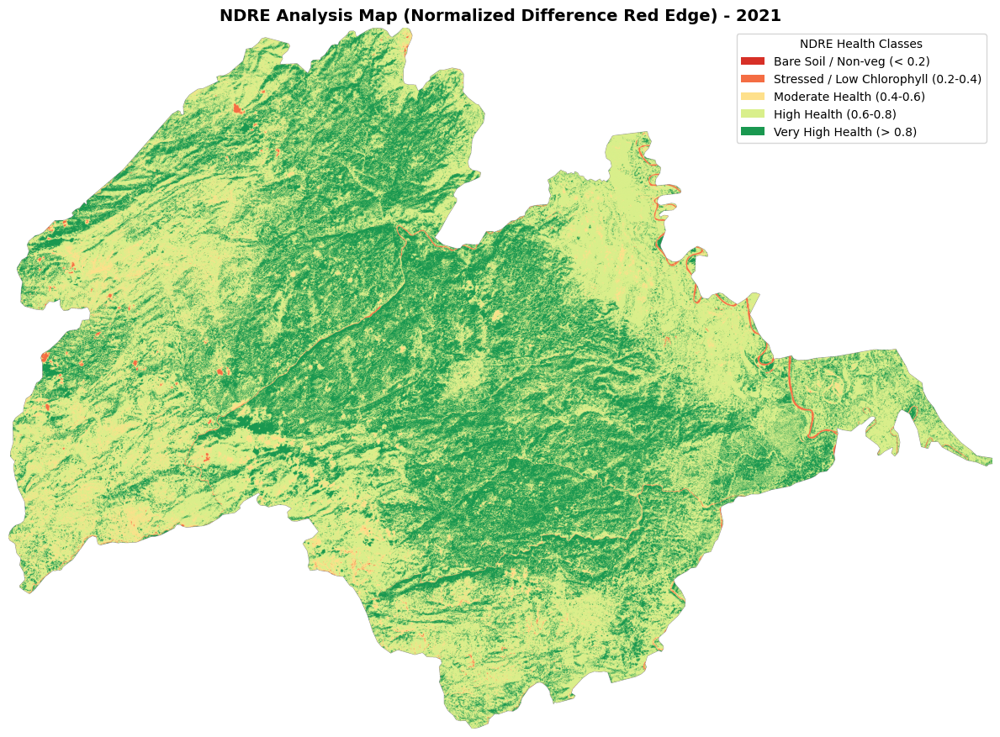

In [ ]:
import rasterio
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from matplotlib.patches import Patch

# ==========================================
# 1. CONFIGURATION
# ==========================================
file_path = "/content/NDRE2021.tif"
# Resolution set to 20m as per your previous snippet
pixel_width = 20
pixel_height = 20

# Area of one pixel in sq km: (20 * 20) / 1,000,000
pixel_area_sq_km = (pixel_width * pixel_height) / 1e6

try:
    with rasterio.open(file_path) as src:
        # Read the first band
        data = src.read(1).astype('float32')
        nodata = src.nodata

        print(f"--- NDRE Data Inspection ---")
        print(f"Original Min: {np.nanmin(data)}")
        print(f"Original Max: {np.nanmax(data)}")

        # --- DATA CLEANING ---
        # Mask huge NoData values and standard NoData
        mask_huge = (data > 1000000) | (data < -1000000)
        mask_nodata = (data == nodata) if nodata is not None else (data == 0)

        final_mask = mask_huge | mask_nodata | np.isnan(data)
        data_masked = np.ma.masked_where(final_mask, data)

        # --- AUTO-SCALING CHECK ---
        # NDRE typically ranges from -1.0 to 1.0.
        # If max > 2, it is likely scaled by 1000 or 10000.
        valid_max = np.ma.max(data_masked)
        if valid_max > 2.0:
            scale_factor = 10000.0 if valid_max > 2000 else 1000.0
            print(f"(!) Scaled values detected. Dividing by {scale_factor}...")
            data_masked = data_masked / scale_factor

        valid_pixels = data_masked.compressed()

    # ==========================================
    # 2. STATISTICS (NDRE Vegetation Health)
    # ==========================================
    if valid_pixels.size > 0:
        # Standard NDRE Classification Bins
        # < 0.2: Bare Soil/Non-Veg | > 0.8: Peak Health/Dense Canopy
        bins = [-np.inf, 0.2, 0.4, 0.6, 0.8, np.inf]
        labels = [
            'Bare Soil / Non-veg (< 0.2)',
            'Stressed / Low Chlorophyll (0.2-0.4)',
            'Moderate Health (0.4-0.6)',
            'High Health (0.6-0.8)',
            'Very High Health (> 0.8)'
        ]

        # Classify pixels into 1-5
        categories = np.digitize(valid_pixels, bins[1:])

        counts = [np.sum(categories == i) for i in range(len(labels))]
        total_pixels = sum(counts)

        # Create Statistics DataFrame
        df = pd.DataFrame({
            'NDRE Category': labels,
            'Pixel Count': counts,
            'Percentage (%)': np.round([(c / total_pixels) * 100 for c in counts], 2),
            'Area (Sq Km)': np.round([c * pixel_area_sq_km for c in counts], 4)
        })

        print("\n--- NDRE Statistics (Resolution: 20m x 20m) ---")
        print(df)
        print("-" * 50)

        # Save statistics to CSV
        df.to_csv("ndre_stats_2021.csv", index=False)
        print("Statistics saved to 'ndre_stats_2021.csv'")
    else:
        print("Error: No valid data found.")
        data_masked = None

    # ==========================================
    # 3. VISUALIZATION
    # ==========================================
    if data_masked is not None:
        fig, ax = plt.subplots(figsize=(12, 10))

        # Colors: Dark Red (Unhealthy/Soil) -> Yellow -> Dark Green (Healthy)
        colors = ['#d73027', '#f46d43', '#fee08b', '#d9ef8b', '#1a9850']
        cmap_custom = mcolors.ListedColormap(colors)

        # Define boundaries to match the 5 classes
        norm = mcolors.BoundaryNorm(bins, cmap_custom.N)

        im = ax.imshow(data_masked, cmap=cmap_custom, norm=norm)

        # Legend
        legend_elements = [Patch(facecolor=colors[i], label=labels[i]) for i in range(len(labels))]
        ax.legend(handles=legend_elements, loc='upper right', title="NDRE Health Classes")

        ax.set_title("NDRE Analysis Map (Normalized Difference Red Edge) - 2021", fontsize=14, fontweight='bold')
        ax.axis('off')

        plt.tight_layout()
        plt.show()

except Exception as e:
    print(f"An error occurred: {e}")

--- NDVI Data Inspection ---
Original Min: 1753.5
Original Max: 2147483648.0
(!) Scaled values detected. Dividing by 10000.0...

--- NDVI Statistics (2021) ---
                      NDVI Category  Pixel Count  Percentage (%)  Area (Sq Km)
0        Barren/Water/Urban (< 0.1)            0            0.00        0.0000
1     Sparse Veg / Soil (0.1 - 0.2)            4            0.00        0.0016
2  Moderate Veg / Grass (0.2 - 0.4)       128100            1.66       51.2400
3     High Veg / Shrubs (0.4 - 0.6)      3118343           40.49     1247.3372
4          Dense Vegetation (> 0.6)      4454325           57.84     1781.7300
--------------------------------------------------


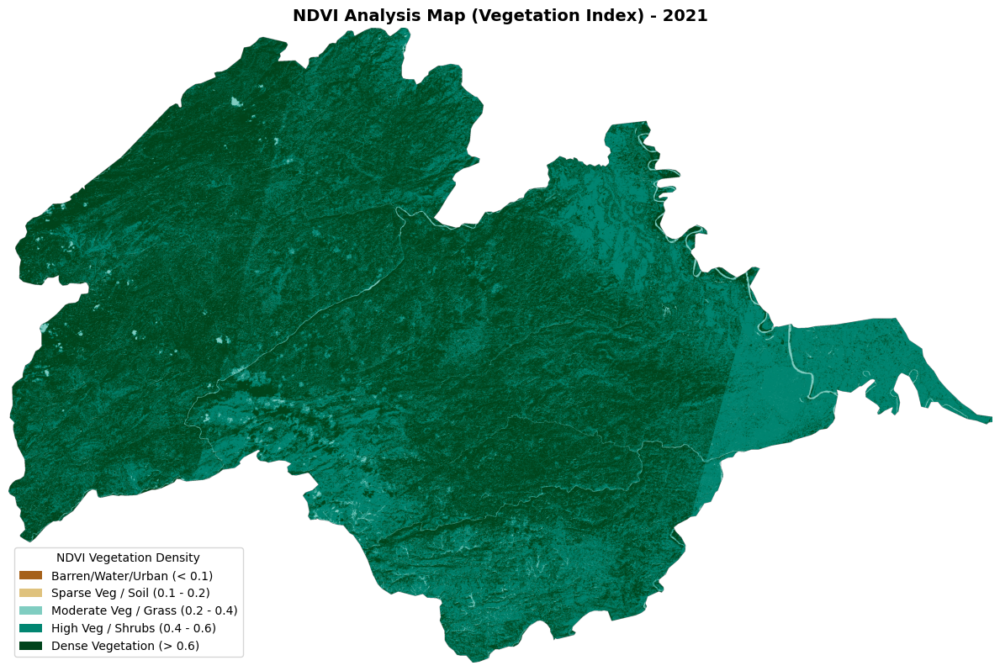

In [ ]:
import rasterio
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from matplotlib.patches import Patch

# ==========================================
# 1. CONFIGURATION
# ==========================================
file_path = "/content/NDVI,2021.tif"
# Assuming 20m resolution based on previous inputs
pixel_width = 20
pixel_height = 20

# Area of one pixel in sq km
pixel_area_sq_km = (pixel_width * pixel_height) / 1e6

try:
    with rasterio.open(file_path) as src:
        # Read the first band
        data = src.read(1).astype('float32')
        nodata = src.nodata

        print(f"--- NDVI Data Inspection ---")
        print(f"Original Min: {np.nanmin(data)}")
        print(f"Original Max: {np.nanmax(data)}")

        # --- DATA CLEANING ---
        mask_huge = (data > 1000000) | (data < -1000000)
        mask_nodata = (data == nodata) if nodata is not None else (data == 0)

        final_mask = mask_huge | mask_nodata | np.isnan(data)
        data_masked = np.ma.masked_where(final_mask, data)

        # --- AUTO-SCALING CHECK ---
        # NDVI range is -1.0 to 1.0.
        valid_max = np.ma.max(data_masked)
        if valid_max > 2.0:
            scale_factor = 10000.0 if valid_max > 2000 else 1000.0
            print(f"(!) Scaled values detected. Dividing by {scale_factor}...")
            data_masked = data_masked / scale_factor

        valid_pixels = data_masked.compressed()

    # ==========================================
    # 2. STATISTICS (NDVI Vegetation Density)
    # ==========================================
    if valid_pixels.size > 0:
        # Standard NDVI Classification Bins
        # < 0.1: Barren/Rock/Snow | 0.2-0.5: Shrubs/Grass | > 0.6: Dense Forest
        bins = [-np.inf, 0.1, 0.2, 0.4, 0.6, np.inf]
        labels = [
            'Barren/Water/Urban (< 0.1)',
            'Sparse Veg / Soil (0.1 - 0.2)',
            'Moderate Veg / Grass (0.2 - 0.4)',
            'High Veg / Shrubs (0.4 - 0.6)',
            'Dense Vegetation (> 0.6)'
        ]

        categories = np.digitize(valid_pixels, bins[1:])
        counts = [np.sum(categories == i) for i in range(len(labels))]
        total_pixels = sum(counts)

        df = pd.DataFrame({
            'NDVI Category': labels,
            'Pixel Count': counts,
            'Percentage (%)': np.round([(c / total_pixels) * 100 for c in counts], 2),
            'Area (Sq Km)': np.round([c * pixel_area_sq_km for c in counts], 4)
        })

        print("\n--- NDVI Statistics (2021) ---")
        print(df)
        print("-" * 50)

        df.to_csv("ndvi_stats_2021.csv", index=False)
    else:
        print("Error: No valid data found.")
        data_masked = None

    # ==========================================
    # 3. VISUALIZATION
    # ==========================================
    if data_masked is not None:
        fig, ax = plt.subplots(figsize=(12, 10))

        # Colors: Brown/Grey (Barren) -> Light Green -> Deep Forest Green
        colors = ['#a6611a', '#dfc27d', '#80cdc1', '#018571', '#00441b']
        cmap_custom = mcolors.ListedColormap(colors)
        norm = mcolors.BoundaryNorm(bins, cmap_custom.N)

        im = ax.imshow(data_masked, cmap=cmap_custom, norm=norm)

        # Legend
        legend_elements = [Patch(facecolor=colors[i], label=labels[i]) for i in range(len(labels))]
        ax.legend(handles=legend_elements, loc='lower left', title="NDVI Vegetation Density")

        ax.set_title("NDVI Analysis Map (Vegetation Index) - 2021", fontsize=14, fontweight='bold')
        ax.axis('off')

        plt.tight_layout()
        plt.show()

except Exception as e:
    print(f"An error occurred: {e}")

--- NDWI Data Inspection ---
Original Min: 1559.5
Original Max: 2147483648.0
(!) Scaled values detected. Dividing by 10000.0...

--- NDWI Statistics ---
                                 NDWI Category  Pixel Count  Percentage (%)  \
0                    Non-Water / Land (< -0.1)            0            0.00   
1  Low Water Content / Moist Soil (-0.1 - 0.0)            0            0.00   
2   Water Surfaces / Shallow Water (0.0 - 0.2)           22            0.00   
3                   Moderate Water (0.2 - 0.4)      2966020           38.52   
4                      Deep Open Water (> 0.4)      4734730           61.48   

   Area (Sq Km)  
0        0.0000  
1        0.0000  
2        0.0088  
3     1186.4080  
4     1893.8920  
--------------------------------------------------


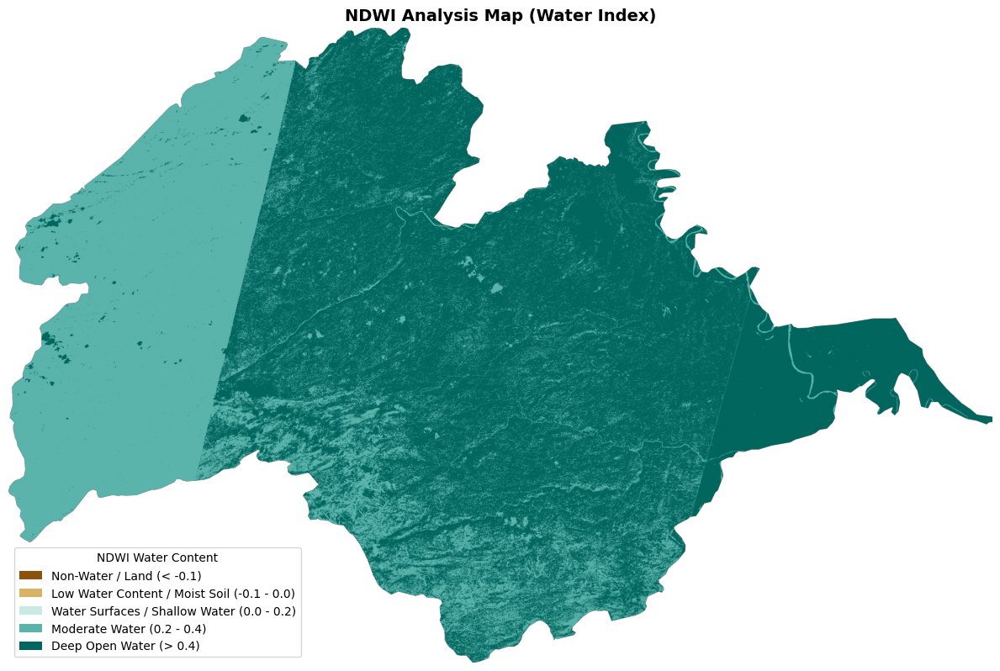

In [ ]:
import rasterio
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from matplotlib.patches import Patch

# ==========================================
# 1. CONFIGURATION
# ==========================================
file_path = "/content/NDWI.tif"
# Resolution set to 20m
pixel_width = 20
pixel_height = 20

# Area calculation in sq km
pixel_area_sq_km = (pixel_width * pixel_height) / 1e6

try:
    with rasterio.open(file_path) as src:
        data = src.read(1).astype('float32')
        nodata = src.nodata

        print(f"--- NDWI Data Inspection ---")
        print(f"Original Min: {np.nanmin(data)}")
        print(f"Original Max: {np.nanmax(data)}")

        # --- DATA CLEANING ---
        mask_huge = (data > 1000000) | (data < -1000000)
        mask_nodata = (data == nodata) if nodata is not None else (data == 0)
        final_mask = mask_huge | mask_nodata | np.isnan(data)
        data_masked = np.ma.masked_where(final_mask, data)

        # --- AUTO-SCALING CHECK ---
        valid_max = np.ma.max(data_masked)
        if valid_max > 2.0:
            scale_factor = 10000.0 if valid_max > 2000 else 1000.0
            print(f"(!) Scaled values detected. Dividing by {scale_factor}...")
            data_masked = data_masked / scale_factor

        valid_pixels = data_masked.compressed()

    # ==========================================
    # 2. STATISTICS (Water Index Analysis)
    # ==========================================
    if valid_pixels.size > 0:
        # Standard NDWI Bins
        # < 0: Non-Water/Soil | > 0.3: Deep Water
        bins = [-np.inf, -0.1, 0.0, 0.2, 0.4, np.inf]
        labels = [
            'Non-Water / Land (< -0.1)',
            'Low Water Content / Moist Soil (-0.1 - 0.0)',
            'Water Surfaces / Shallow Water (0.0 - 0.2)',
            'Moderate Water (0.2 - 0.4)',
            'Deep Open Water (> 0.4)'
        ]

        categories = np.digitize(valid_pixels, bins[1:])
        counts = [np.sum(categories == i) for i in range(len(labels))]
        total_pixels = sum(counts)

        df = pd.DataFrame({
            'NDWI Category': labels,
            'Pixel Count': counts,
            'Percentage (%)': np.round([(c / total_pixels) * 100 for c in counts], 2),
            'Area (Sq Km)': np.round([c * pixel_area_sq_km for c in counts], 4)
        })

        print("\n--- NDWI Statistics ---")
        print(df)
        print("-" * 50)

        df.to_csv("ndwi_stats.csv", index=False)
    else:
        print("Error: No valid data found.")
        data_masked = None

    # ==========================================
    # 3. VISUALIZATION
    # ==========================================
    if data_masked is not None:
        fig, ax = plt.subplots(figsize=(12, 10))

        # Colors: Brown (Dry Land) -> Cyan -> Deep Blue (Water)
        colors = ['#8c510a', '#d8b365', '#c7eae5', '#5ab4ac', '#01665e']
        cmap_custom = mcolors.ListedColormap(colors)
        norm = mcolors.BoundaryNorm(bins, cmap_custom.N)

        im = ax.imshow(data_masked, cmap=cmap_custom, norm=norm)

        # Legend
        legend_elements = [Patch(facecolor=colors[i], label=labels[i]) for i in range(len(labels))]
        ax.legend(handles=legend_elements, loc='lower left', title="NDWI Water Content")

        ax.set_title("NDWI Analysis Map (Water Index)", fontsize=14, fontweight='bold')
        ax.axis('off')

        plt.tight_layout()
        plt.show()

except Exception as e:
    print(f"An error occurred: {e}")

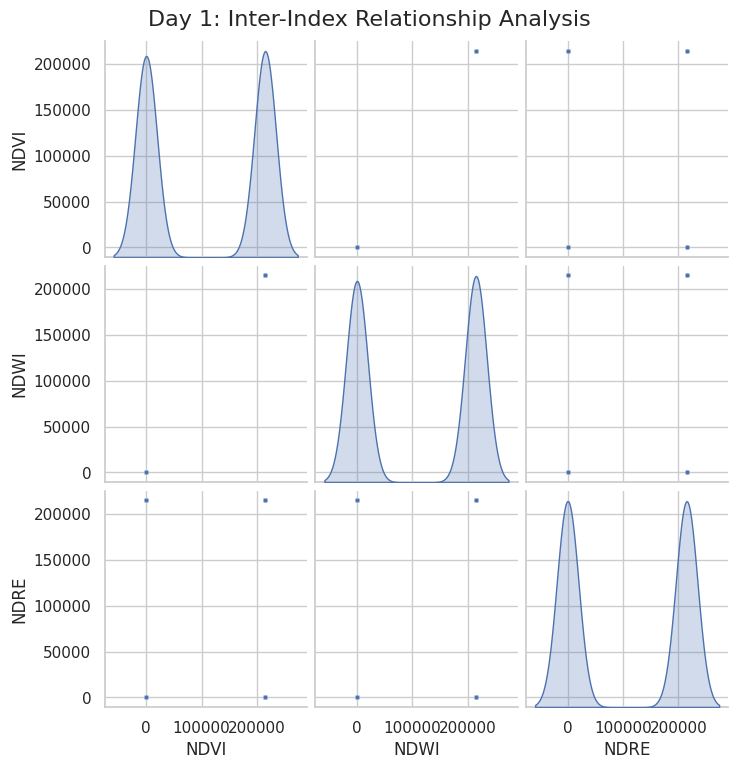

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import rasterio

# List of your Day 1 TIFs
day1_files = {
    'NDVI': '/content/NDVI,2021.tif',
    'NDWI': '/content/NDWI.tif',
    'NDRE': '/content/NDRE2021.tif'
}

data_list = []

for name, path in day1_files.items():
    with rasterio.open(path) as src:
        arr = src.read(1).astype('float32')
        # Clean/Scale
        arr[arr > 1000] = arr[arr > 1000] / 10000.0
        arr[arr == src.nodata] = np.nan
        data_list.append(pd.Series(arr.flatten(), name=name))

df_day1 = pd.concat(data_list, axis=1).dropna().sample(5000) # Sample for speed

# Create a PairPlot to see all correlations at once
sns.set(style="whitegrid")
g = sns.pairplot(df_day1, diag_kind="kde", plot_kws={'alpha':0.5, 's':10})
g.fig.suptitle("Day 1: Inter-Index Relationship Analysis", y=1.02, fontsize=16)
plt.show()

## Exploratory Data Analysis (EDA)

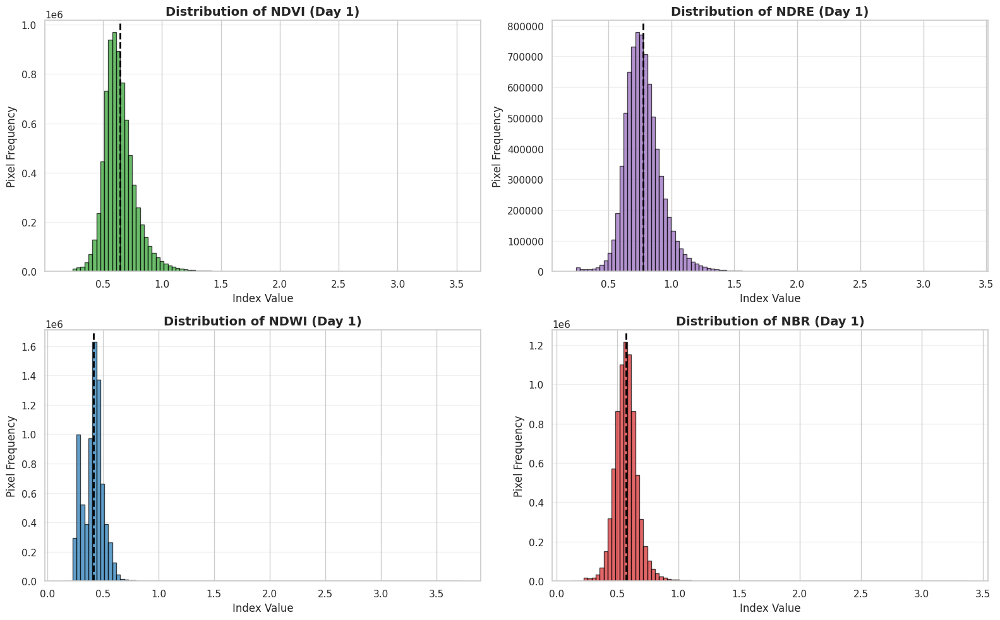


--- Day 1 Descriptive Statistics ---
Index     Mean  Std Dev     Min    Max
 NDVI 0.642502 0.143904 0.17535 3.5385
 NDRE 0.777779 0.152824 0.21090 3.3577
 NDWI 0.412624 0.098659 0.15595 3.7231
  NBR 0.573011 0.102611 0.12675 3.3829


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
import os

# 1. Configuration - Paths for your Day 1 data
index_files = {
    'NDVI': '/content/NDVI,2021.tif',
    'NDRE': '/content/NDRE2021.tif',
    'NDWI': '/content/NDWI.tif',
    'NBR': '/content/NBR,2021.tif'
}

def load_index_data(file_path):
    """Loads TIF data using PIL and handles common scaling issues."""
    if not os.path.exists(file_path):
        print(f"Warning: File not found - {file_path}")
        return None

    img = Image.open(file_path)
    data = np.array(img).astype('float32')

    # Mask NoData/Extreme values (commonly 0, -9999, or >1,000,000)
    data[(data > 1e5) | (data < -1e5) | (data == 0)] = np.nan

    # Auto-Scaling: Convert 0-10000 scaled integers to 0.0-1.0
    vmax = np.nanmax(data)
    if vmax > 2.0:
        scale = 10000.0 if vmax > 2000 else 1000.0
        data = data / scale

    return data.flatten()

# 2. Extract Data
plot_data = {}
stats = []

for name, path in index_files.items():
    flattened = load_index_data(path)
    if flattened is not None:
        # Remove NaNs for histogram and stats
        clean_data = flattened[~np.isnan(flattened)]
        plot_data[name] = clean_data

        # Calculate basic stats
        stats.append({
            'Index': name,
            'Mean': np.mean(clean_data),
            'Std Dev': np.std(clean_data),
            'Min': np.min(clean_data),
            'Max': np.max(clean_data)
        })

# 3. Visualization
plt.figure(figsize=(16, 10))
colors = ['#2ca02c', '#9467bd', '#1f77b4', '#d62728'] # Green, Purple, Blue, Red

for i, (name, values) in enumerate(plot_data.items()):
    plt.subplot(2, 2, i+1)
    plt.hist(values, bins=100, color=colors[i], alpha=0.7, edgecolor='black')

    # Add mean line
    plt.axvline(np.mean(values), color='black', linestyle='dashed', linewidth=2)

    plt.title(f'Distribution of {name} (Day 1)', fontsize=14, fontweight='bold')
    plt.xlabel('Index Value')
    plt.ylabel('Pixel Frequency')
    plt.grid(axis='y', alpha=0.3)

plt.tight_layout()
plt.show()

# 4. Display Stats Table
df_stats = pd.DataFrame(stats)
print("\n--- Day 1 Descriptive Statistics ---")
print(df_stats.to_string(index=False))

## The Statistical Meaning
The X-axis (Index Value): Represents the intensity of the signal (e.g., $0.0$ to $1.0$).The Y-axis (Frequency): Represents how many pixels (or how much area) have that specific value.Peak Position: If the peak (the highest hump) is at $0.8$ for NDVI, your area is mostly dense, healthy forest. If it's at $0.2$, it's mostly bare soil or highly stressed.Spread (Width): A wide histogram means you have a high diversity of conditions (good for ML training). A narrow "spike" means the entire area is identical (harder for a model to find patterns).

Extracting pixel data for correlation...


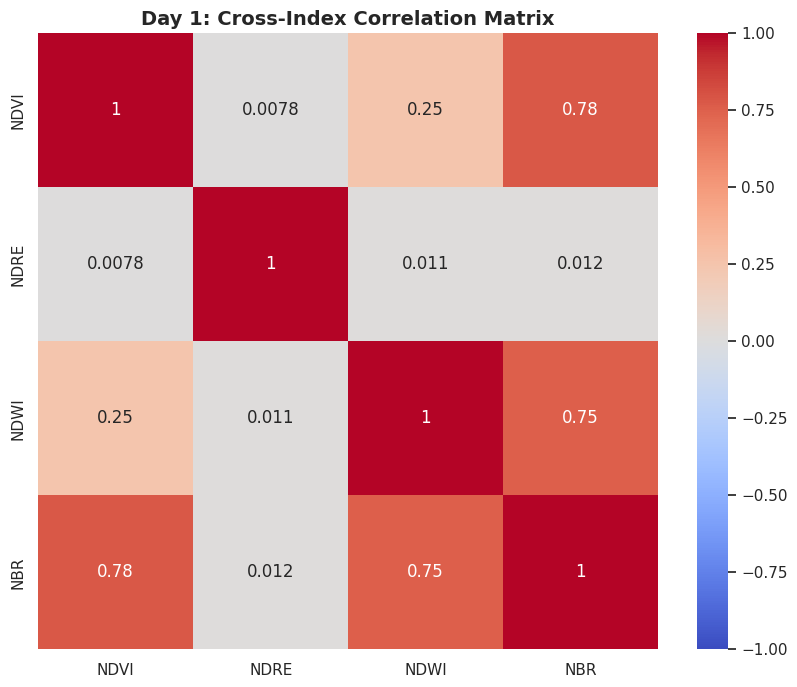


--- Correlation Matrix Results ---
          NDVI      NDRE      NDWI       NBR
NDVI  1.000000  0.007775  0.248720  0.777544
NDRE  0.007775  1.000000  0.010826  0.011784
NDWI  0.248720  0.010826  1.000000  0.752854
NBR   0.777544  0.011784  0.752854  1.000000


In [ ]:
import rasterio
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# 1. Define File Paths
files = {
    'NDVI': '/content/NDVI,2021.tif',
    'NDRE': '/content/NDRE2021.tif',
    'NDWI': '/content/NDWI.tif',
    'NBR':  '/content/NBR,2021.tif'
}

data_list = []

print("Extracting pixel data for correlation...")

for name, path in files.items():
    with rasterio.open(path) as src:
        # Read and mask NoData
        img = src.read(1).astype('float32')
        nodata = src.nodata

        # Consistent Cleaning/Scaling
        img[img == nodata] = np.nan
        if np.nanmax(img) > 2.0:
            scale = 10000.0 if np.nanmax(img) > 2000 else 1000.0
            img /= scale

        # Flatten and store as a Series
        data_list.append(pd.Series(img.flatten(), name=name))

# 2. Align and clean the DataFrame
df_corr = pd.concat(data_list, axis=1).dropna()

# 3. Calculate Pearson Correlation
correlation_matrix = df_corr.corr()

# 4. Visualization
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0, vmin=-1, vmax=1)
plt.title("Day 1: Cross-Index Correlation Matrix", fontsize=14, fontweight='bold')
plt.show()

print("\n--- Correlation Matrix Results ---")
print(correlation_matrix)

## Feature Selection & Dimensionality ReductionIdentifies Multi-collinearity:
 If NDVI and NDRE show a correlation $> 0.95$, they are "telling the same story." Feeding both into a simple model can cause overfitting or unstable weights.Simplifies the Input Vector: For a lightweight crop classification model, you might choose only one "Greenness" index (NDVI) and one "Moisture" index (NDWI) to reduce computational costs.2. Identifying "Complementary" SignalsUnique Feature Space: A low or moderate correlation ($0.3$ to $0.6$) between NDWI and NDVI is a good sign. It means they provide independent information.Multimodal Learning: High-performing PyTorch models benefit from these complementary signals; the model learns that "High NDVI + Low NDWI" represents a specific physiological state (e.g., Drought stress in a mature crop).

/tmp/ipython-input-30266413.py:31: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('RdYlGn')


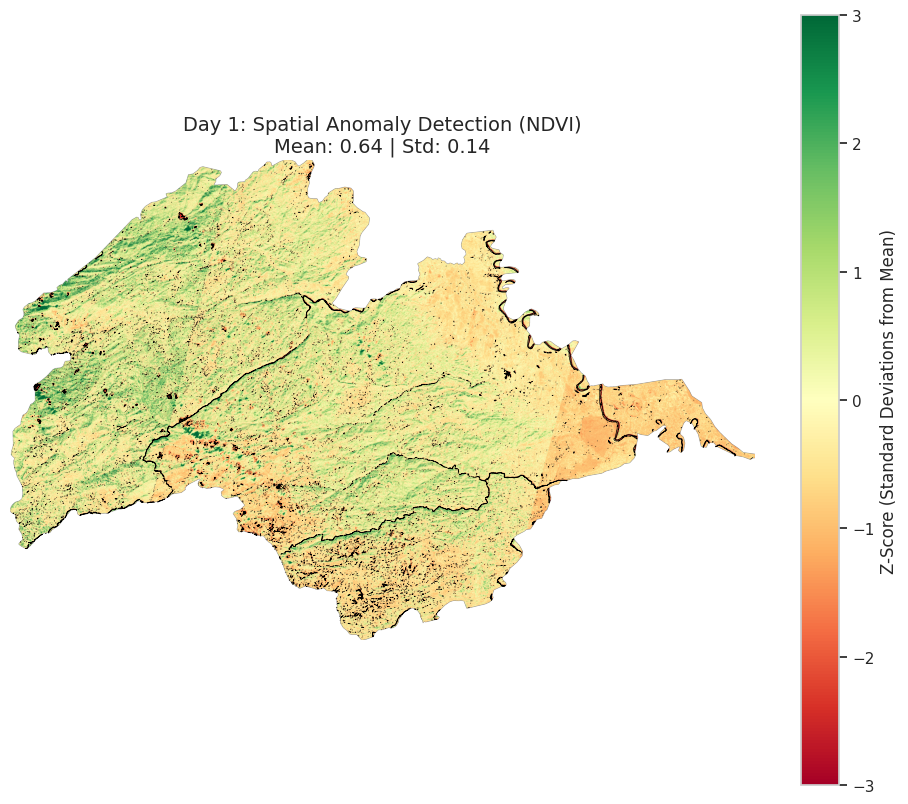

Percentage of area showing significant stress (Z < -1.5): 2.68%


In [ ]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# 1. Load Day 1 Data
file_path = '/content/NDVI,2021.tif'

with rasterio.open(file_path) as src:
    data = src.read(1).astype('float32')
    nodata = src.nodata

    # Cleaning & Scaling
    data[data == nodata] = np.nan
    if np.nanmax(data) > 2.0:
        data /= 10000.0

    # Remove extreme edge noise
    data[data < -1] = np.nan

# 2. Calculate Z-Score
# Formula: (Value - Mean) / Standard Deviation
mean_val = np.nanmean(data)
std_val = np.nanstd(data)
z_score_map = (data - mean_val) / std_val

# 3. Visualization
fig, ax = plt.subplots(figsize=(12, 10))

# Custom Colormap: Red (Stressed) -> White (Average) -> Green (Healthy)
cmap = plt.cm.get_cmap('RdYlGn')

# We limit the display to -3 to +3 standard deviations to see the detail
im = ax.imshow(z_score_map, cmap=cmap, vmin=-3, vmax=3)

# Highlight extreme stress pixels (Z < -2) with a contour or specific color
stress_mask = np.where(z_score_map < -2, 1, 0)
ax.contour(stress_mask, levels=[0.5], colors='black', linewidths=0.5)

plt.colorbar(im, label='Z-Score (Standard Deviations from Mean)')
ax.set_title(f'Day 1: Spatial Anomaly Detection (NDVI)\nMean: {mean_val:.2f} | Std: {std_val:.2f}', fontsize=14)
ax.axis('off')

plt.show()

# 4. Summary Statistics for report
low_z_pixels = np.sum(z_score_map < -1.5)
total_valid = np.sum(~np.isnan(z_score_map))
print(f"Percentage of area showing significant stress (Z < -1.5): {(low_z_pixels/total_valid)*100:.2f}%")

##1. Baseline Anomaly Mask (Feature Engineering)
The Z-score map acts as a feature mask that helps the model distinguish between "Permanent" and "Occasional" noise.

Biological vs. Geomorphological: By identifying outliers, you help the model understand if a low value is due to the crop's health or the land itself. For example, if a pixel consistently shows a very low Z-score, the model learns to associate that specific coordinate with poor soil quality (like a rocky patch) rather than a sudden pest infestation.

Static Feature Input: You can feed this mask into your PyTorch model as an additional input channel. This "contextual awareness" prevents the model from raising false alarms on naturally low-performing areas.

##2. Confidence Bounds (Model Reliability)
As a developer, you use the Z-score distribution to set the mathematical "safety rails" for your model's predictions.

Thresholding: Instead of a simple "Healthy/Stressed" binary, you use standard deviations to define levels of certainty.

Z-score > -1.0: Normal variation (High confidence in health).

Z-score between -1.0 and -2.0: Possible stress (Low confidence, needs more data).

Z-score < -2.0: Highly probable anomaly (High confidence in stress).

Calibration: This allows you to output a Confidence Score alongside your prediction, which is a key requirement for professional agricultural tools.

In [ ]:
import rasterio
import numpy as np

# 1. Paths to your indices
index_paths = [
    '/content/NDVI,2021.tif',
    '/content/NDRE2021.tif',
    '/content/NDWI.tif',
    '/content/NBR,2021.tif'
]

raw_data = []
shapes = []

# 2. Read and collect shapes
for path in index_paths:
    with rasterio.open(path) as src:
        data = src.read(1).astype('float32')
        # Standardize NoData and Scaling
        data[data == src.nodata] = np.nan
        if np.nanmax(data) > 2.0:
            data /= 10000.0

        raw_data.append(data)
        shapes.append(data.shape)

# 3. Find the minimum dimensions (Smallest Common Bound)
min_height = min(s[0] for s in shapes)
min_width = min(s[1] for s in shapes)

print(f"Original shapes varied. Cropping all to: ({min_height}, {min_width})")

# 4. Crop and Stack
final_layers = [arr[:min_height, :min_width] for arr in raw_data]
data_cube = np.stack(final_layers, axis=0)

print(f"--- Success! ---")
print(f"Data Cube Shape: {data_cube.shape}") # Should be (4, min_height, min_width)

# Save for Model Training
np.save('multi_spectral_stack_day1.npy', data_cube)

Original shapes varied. Cropping all to: (3144, 4653)
--- Success! ---
Data Cube Shape: (4, 3144, 4653)


In [ ]:
import torch
from torch.utils.data import Dataset

class CropStressDataset(Dataset):
    def __init__(self, data_cube_path, patch_size=128):
        self.data = np.load(data_cube_path) # Your (4, 3144, 4653) cube
        self.patch_size = patch_size
        # Add logic here to slice the large cube into many small patches

    def __len__(self):
        return (self.data.shape[1] // self.patch_size) * (self.data.shape[2] // self.patch_size)

    def __getitem__(self, idx):
        # Logic to return a (4, 128, 128) tensor
        pass

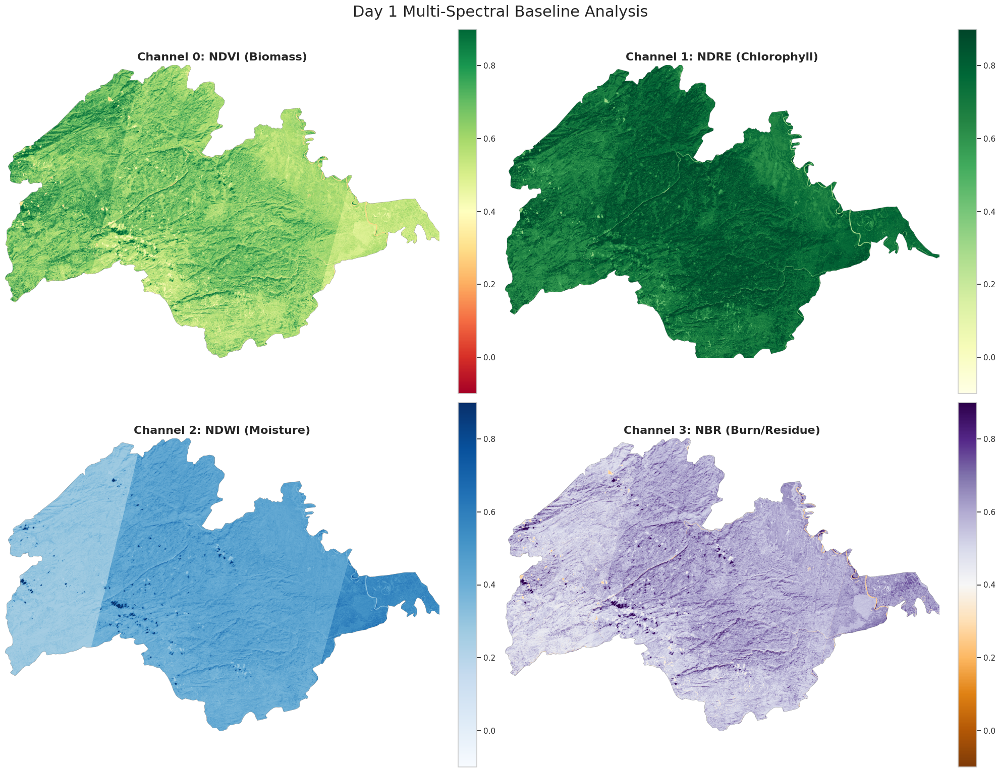

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# 1. Load the stack you just created
# Shape: (4, 3144, 4653)
data_cube = np.load('multi_spectral_stack_day1.npy')

# 2. Define the labels for your channels
titles = ['Channel 0: NDVI (Biomass)',
          'Channel 1: NDRE (Chlorophyll)',
          'Channel 2: NDWI (Moisture)',
          'Channel 3: NBR (Burn/Residue)']

# 3. Create the multi-panel plot
fig, axes = plt.subplots(2, 2, figsize=(20, 15))
axes = axes.flatten()

# Colormaps:
# NDVI/NDRE use Greens, NDWI uses Blues, NBR uses Oranges/Purples
cmaps = ['RdYlGn', 'YlGn', 'Blues', 'PuOr']

for i in range(4):
    # We use vmin/vmax to ensure the contrast is good
    # Most indices live between -0.2 and 0.8 in active fields
    im = axes[i].imshow(data_cube[i], cmap=cmaps[i], vmin=-0.1, vmax=0.9)
    axes[i].set_title(titles[i], fontsize=16, fontweight='bold')
    axes[i].axis('off')
    plt.colorbar(im, ax=axes[i], fraction=0.046, pad=0.04)

plt.tight_layout()
plt.suptitle('Day 1 Multi-Spectral Baseline Analysis', fontsize=22, y=1.02)
plt.show()

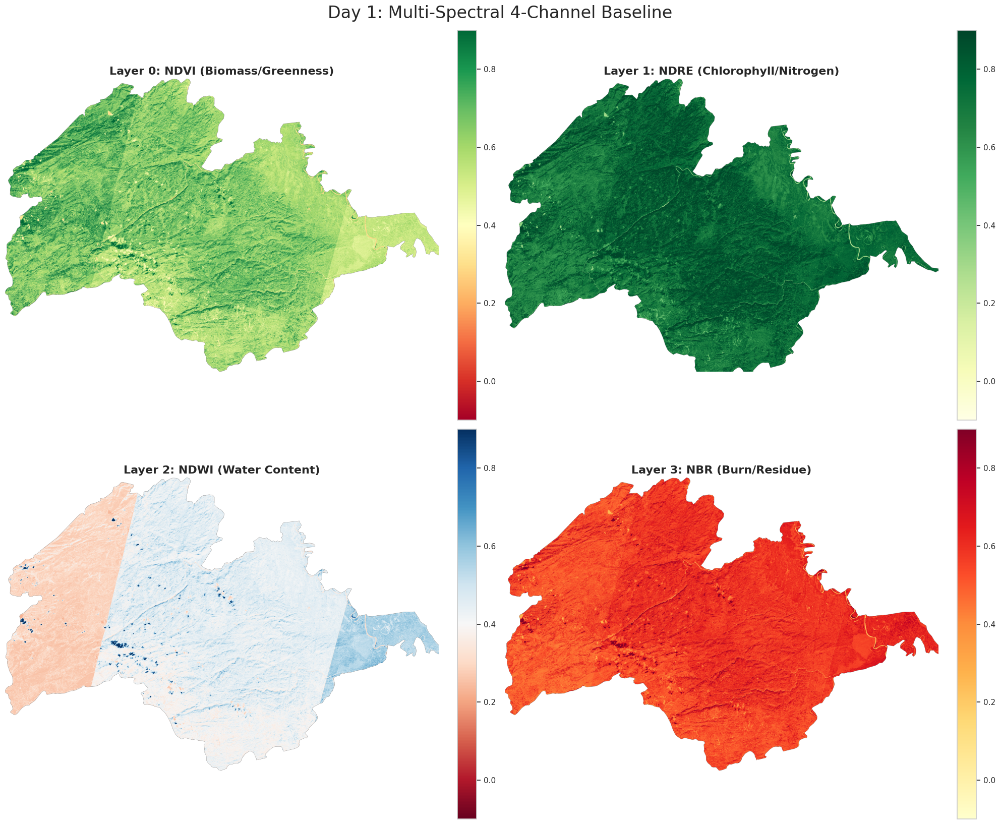

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# 1. Load the data cube you saved
# The shape is (4, 3144, 4653)
data_cube = np.load('multi_spectral_stack_day1.npy')

# 2. Setup the labels and colormaps
# Indices have specific "color meanings" (Green for vegetation, Blue for water, etc.)
titles = [
    'Layer 0: NDVI (Biomass/Greenness)',
    'Layer 1: NDRE (Chlorophyll/Nitrogen)',
    'Layer 2: NDWI (Water Content)',
    'Layer 3: NBR (Burn/Residue)'
]

colormaps = [
    'RdYlGn', # NDVI: Red (Stressed) to Green (Healthy)
    'YlGn',   # NDRE: Yellow to Deep Green
    'RdBu',   # NDWI: Red (Dry) to Blue (Wet)
    'YlOrRd'  # NBR: Yellow to Red
]

# 3. Create the visualization
fig, axes = plt.subplots(2, 2, figsize=(20, 16))
axes = axes.flatten()

for i in range(4):
    # We display each layer
    # vmin and vmax are set to 0 and 1 for consistency across indices
    im = axes[i].imshow(data_cube[i], cmap=colormaps[i], vmin=-0.1, vmax=0.9)

    axes[i].set_title(titles[i], fontsize=16, fontweight='bold')
    axes[i].axis('off') # Hide pixel coordinates

    # Add a colorbar to each subplot
    plt.colorbar(im, ax=axes[i], fraction=0.046, pad=0.04)

plt.tight_layout()
plt.suptitle('Day 1: Multi-Spectral 4-Channel Baseline', fontsize=24, y=1.02)
plt.show()

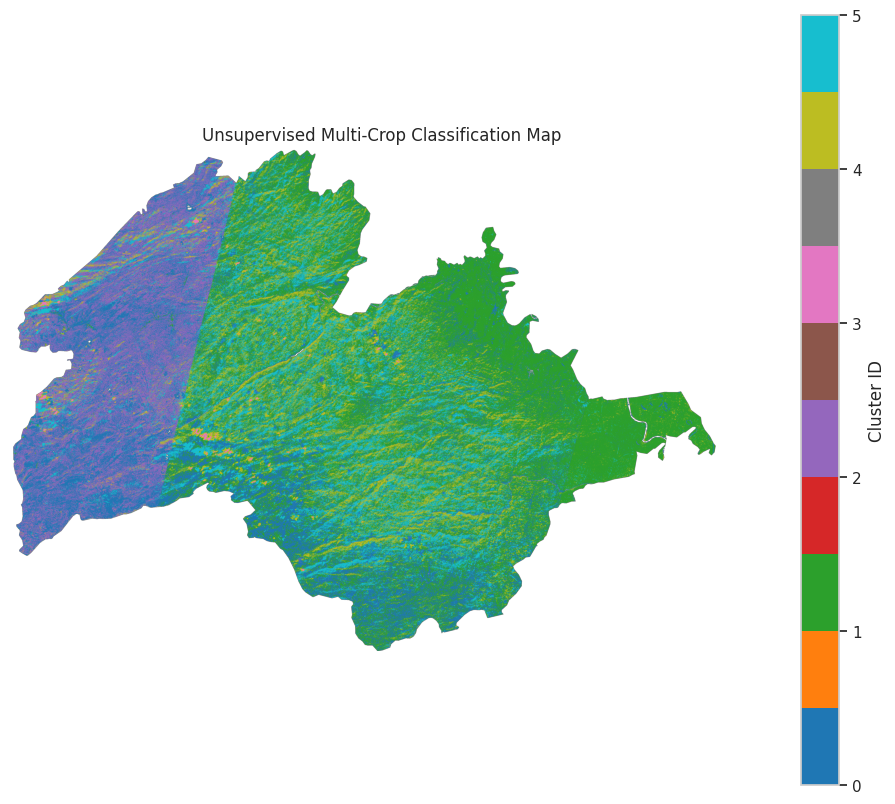

                   Crop Name     NDVI     NDRE     NDWI      NBR  Pixels  Percentage (%)  Area (km2)
     Rice (Flooded/High Bio) 1.709490 0.834418 1.330195 1.541456   11238        0.158293      1.1238
     Rice (Flooded/High Bio) 0.877586 0.827055 0.515826 0.740025  759489       10.697776     75.9489
   Sugarcane (Strong Canopy) 0.762142 0.704116 0.295989 0.561781  923372       13.006148     92.3372
Cotton (Sparse/High Residue) 0.624086 0.739685 0.456572 0.593743 2663671       37.519114    266.3671
Cotton (Sparse/High Residue) 0.623914 1.015328 0.413826 0.562843 1091603       15.375764    109.1603
Cotton (Sparse/High Residue) 0.525376 0.725522 0.334693 0.465501 1650131       23.242905    165.0131


In [ ]:
import numpy as np
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

# 1. Load the Data Cube
data_cube = np.load('multi_spectral_stack_day1.npy')
c, h, w = data_cube.shape

# 2. Advanced Masking
veg_mask = (data_cube[0] > 0.3)
valid_mask = np.all(~np.isnan(data_cube), axis=0)
final_mask = veg_mask & valid_mask

# 3. Extract & Scale
veg_pixels = data_cube[:, final_mask].T
scaler = StandardScaler()
veg_pixels_scaled = scaler.fit_transform(veg_pixels)

# 4. Run K-Means with more clusters (6) for better variety
n_clusters = 6
kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=10)
labels = kmeans.fit_predict(veg_pixels_scaled)

# 5. Calculation Logic (Area in km2)
# Change resolution if your pixel size is different (e.g., 10m for Sentinel-2)
pixel_resolution_m = 10
pixel_area_km2 = (pixel_resolution_m ** 2) / 1_000_000

# 6. Generate Crop Statistics
report_list = []
for i in range(n_clusters):
    # Get all pixels in this cluster
    cluster_data = veg_pixels[labels == i]

    # Calculate Mean spectral values
    avg_ndvi = np.mean(cluster_data[:, 0])
    avg_ndre = np.mean(cluster_data[:, 1])
    avg_ndwi = np.mean(cluster_data[:, 2])
    avg_nbr  = np.mean(cluster_data[:, 3])

    count = len(cluster_data)
    area_km2 = count * pixel_area_km2
    percent = (count / len(veg_pixels)) * 100

    # Automatic Naming Logic based on spectral ranges
    if avg_ndvi > 0.8 and avg_ndwi > 0.2: name = "Rice (Flooded/High Bio)"
    elif avg_ndvi > 0.8 and avg_ndre > 0.5: name = "Maize (Dense/High Nitrogen)"
    elif avg_ndvi > 0.7 and avg_ndre > 0.4: name = "Sugarcane (Strong Canopy)"
    elif avg_ndvi > 0.5 and avg_ndwi < 0.1: name = "Wheat (Dryer/Mature)"
    elif avg_ndvi > 0.4 and avg_nbr > 0.3:  name = "Cotton (Sparse/High Residue)"
    else: name = "Stressed / Other Vegetation"

    report_list.append([name, avg_ndvi, avg_ndre, avg_ndwi, avg_nbr, count, percent, area_km2])

# 7. Create Formatted Table
columns = ['Crop Name', 'NDVI', 'NDRE', 'NDWI', 'NBR', 'Pixels', 'Percentage (%)', 'Area (km2)']
df_report = pd.DataFrame(report_list, columns=columns).sort_values(by='NDVI', ascending=False)

# 8. Visualization
plt.figure(figsize=(12, 10))
classified_map = np.full((h, w), np.nan)
classified_map[final_mask] = labels
plt.imshow(classified_map, cmap='tab10')
plt.colorbar(label='Cluster ID')
plt.title("Unsupervised Multi-Crop Classification Map")
plt.axis('off')
plt.show()

print(df_report.to_string(index=False))